In [198]:
# Import requirement libraries and tools for visualization
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from termcolor import colored

import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import StandardScaler
from sklearn.impute import KNNImputer
from sklearn.cluster import KMeans, MiniBatchKMeans, MeanShift, estimate_bandwidth, AffinityPropagation, Birch, DBSCAN, OPTICS, AgglomerativeClustering 
from yellowbrick.cluster import KElbowVisualizer
import scipy.cluster.hierarchy as sch
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
from sklearn.model_selection import GridSearchCV
from sklearn import set_config
from sklearn.metrics import silhouette_score, calinski_harabasz_score
from sklearn.decomposition import PCA
from itertools import product
from sklearn.neighbors import NearestNeighbors
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA



from kneed import KneeLocator

In [199]:
!pip install kneed

python(41939) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [200]:
!pip install yellowbrick

python(41944) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.


In [201]:
df = pd.read_csv(r"/Users/yaswanthkalyanponugoti/Downloads/Customer_Data.csv")
df

,cust_id,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [202]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   cust_id                           8950 non-null   object 
 1   balance                           8950 non-null   float64
 2   balance_frequency                 8950 non-null   float64
 3   purchases                         8950 non-null   float64
 4   oneoff_purchases                  8950 non-null   float64
 5   installments_purchases            8950 non-null   float64
 6   cash_advance                      8950 non-null   float64
 7   purchases_frequency               8950 non-null   float64
 8   oneoff_purchases_frequency        8950 non-null   float64
 9   purchases_installments_frequency  8950 non-null   float64
 10  cash_advance_frequency            8950 non-null   float64
 11  cash_advance_trx                  8950 non-null   int64  
 12  purcha

In [203]:
df

,cust_id,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,C10001,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [204]:
desc_cust_df

,count,mean,std,min,25%,50%,75%,max
balance,8950.0,1564.474828,2081.531879,0.000000,128.281915,873.385231,2054.140036,19043.13856
balance_frequency,8950.0,0.877271,0.236904,0.000000,0.888889,1.000000,1.000000,1.00000
purchases,8950.0,1003.204834,2136.634782,0.000000,39.635000,361.280000,1110.130000,49039.57000
oneoff_purchases,8950.0,592.437371,1659.887917,0.000000,0.000000,38.000000,577.405000,40761.25000
installments_purchases,8950.0,411.067645,904.338115,0.000000,0.000000,89.000000,468.637500,22500.00000
cash_advance,8950.0,978.871112,2097.163877,0.000000,0.000000,0.000000,1113.821139,47137.21176
purchases_frequency,8950.0,0.490351,0.401371,0.000000,0.083333,0.500000,0.916667,1.00000
oneoff_purchases_frequency,8950.0,0.202458,0.298336,0.000000,0.000000,0.083333,0.300000,1.00000
purchases_installments_frequency,8950.0,0.364437,0.397448,0.000000,0.000000,0.166667,0.750000,1.00000
cash_advance_frequency,8950.0,0.135144,0.200121,0.000000,0.000000,0.000000,0.222222,1.50000


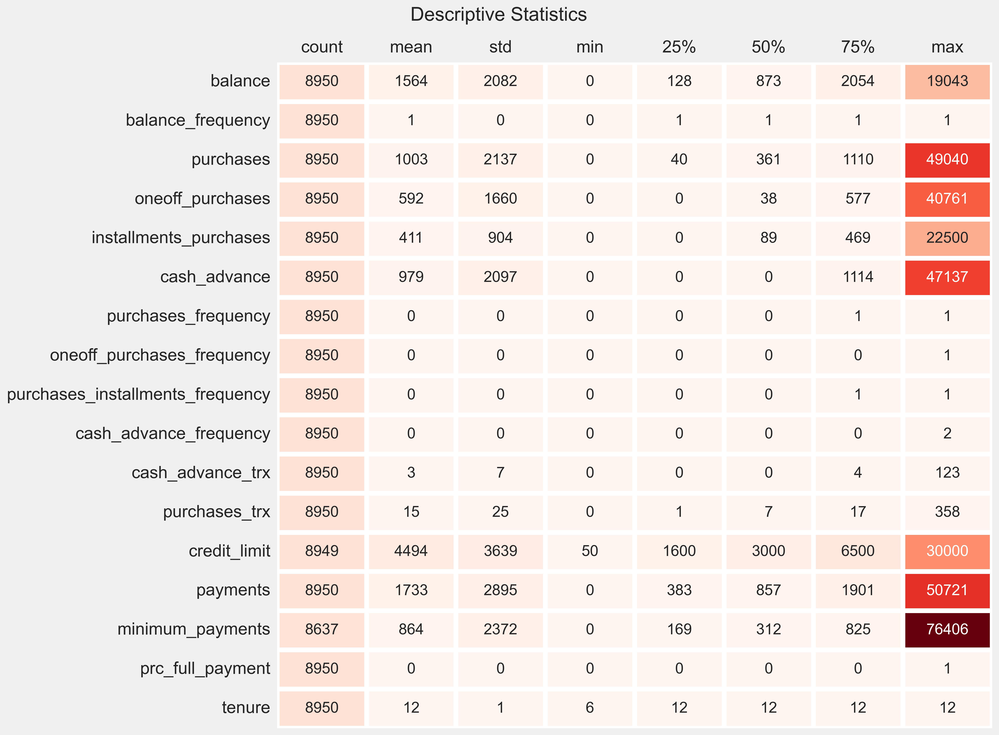

In [205]:
desc_cust = df.select_dtypes(include=['int64','float64']).describe().T
desc_cust_df = pd.DataFrame(index=desc_cust.index, columns=desc_cust.columns, data=desc_cust )

f,ax = plt.subplots(figsize=(12,12),dpi=500)

sns.heatmap(desc_cust_df, annot=True,cmap = "Reds", fmt= '.0f',
            ax=ax,linewidths = 5, cbar = False,
            annot_kws={"size": 16})

ax.xaxis.set_ticks_position('top')
plt.tick_params(left=False, top=False)
plt.xticks(size = 18)
plt.yticks(size = 18)
plt.title("Descriptive Statistics", pad=30, x=0.31, y=1.02)
plt.show()

In [206]:
df = df.drop('cust_id', axis=1)

In [207]:
df

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.000000,6
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [208]:
is_nan = df.isna().sum().to_frame(name='Number_of_NaN')
is_nan.insert(1,'Percent(%)', [round(x/df.shape[0]*100,2) for x in is_nan.Number_of_NaN])

In [209]:
def highlight_non_zero(val):
    return 'background-color: red' if val != 0 else ''


In [210]:
is_nan.style.applymap(highlight_non_zero)

,Number_of_NaN,Percent(%)
balance,0,0.000000
balance_frequency,0,0.000000
purchases,0,0.000000
oneoff_purchases,0,0.000000
installments_purchases,0,0.000000
cash_advance,0,0.000000
purchases_frequency,0,0.000000
oneoff_purchases_frequency,0,0.000000
purchases_installments_frequency,0,0.000000
cash_advance_frequency,0,0.000000


In [211]:
mean_minimum_payments = df['minimum_payments'].mean()
df1=df
df1['minimum_payments'].fillna(mean_minimum_payments, inplace=True)

In [212]:
is_nan1 = df1.isna().sum().to_frame(name='Number_of_NaN')
is_nan1.insert(1,'Percent(%)', [round(x/df1.shape[0]*100,2) for x in is_nan1.Number_of_NaN])
is_nan1.style.applymap(highlight_non_zero)

,Number_of_NaN,Percent(%)
balance,0,0.000000
balance_frequency,0,0.000000
purchases,0,0.000000
oneoff_purchases,0,0.000000
installments_purchases,0,0.000000
cash_advance,0,0.000000
purchases_frequency,0,0.000000
oneoff_purchases_frequency,0,0.000000
purchases_installments_frequency,0,0.000000
cash_advance_frequency,0,0.000000


In [213]:
df1 = df1.drop(df[df.credit_limit.isna()].index, axis=0)
df1

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,864.206542,0.000000,6
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6


In [214]:
is_nan2 = df1.isna().sum().to_frame(name='Number_of_NaN')
is_nan2.insert(1,'Percent(%)', [round(x/df1.shape[0]*100,2) for x in is_nan2.Number_of_NaN])
is_nan2.style.applymap(highlight_non_zero)

,Number_of_NaN,Percent(%)
balance,0,0.000000
balance_frequency,0,0.000000
purchases,0,0.000000
oneoff_purchases,0,0.000000
installments_purchases,0,0.000000
cash_advance,0,0.000000
purchases_frequency,0,0.000000
oneoff_purchases_frequency,0,0.000000
purchases_installments_frequency,0,0.000000
cash_advance_frequency,0,0.000000


In [215]:
df.columns

Index(['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
       'installments_purchases', 'cash_advance', 'purchases_frequency',
       'oneoff_purchases_frequency', 'purchases_installments_frequency',
       'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
       'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
       'tenure'],
      dtype='object')

In [216]:
for i in df.columns :
    print(i,len(df[i].unique()))
    print(df[i].unique())

balance 8871
[  40.900749 3202.467416 2495.148862 ...   23.398673   13.457564
  372.708075]
balance_frequency 43
[0.818182 0.909091 1.       0.636364 0.545455 0.875    0.454545 0.727273
 0.5      0.888889 0.090909 0.272727 0.363636 0.       0.666667 0.75
 0.857143 0.181818 0.333333 0.6      0.3      0.125    0.9      0.833333
 0.8      0.2      0.777778 0.555556 0.25     0.142857 0.571429 0.4
 0.444444 0.714286 0.222222 0.1      0.625    0.428571 0.111111 0.285714
 0.7      0.375    0.166667]
purchases 6203
[  95.4     0.    773.17 ...  291.12  144.4  1093.25]
oneoff_purchases 4014
[   0.    773.17 1499.   ...  734.4  1012.73 1093.25]
installments_purchases 4452
[  95.4     0.   1333.28 ...  113.28  291.12  144.4 ]
cash_advance 4323
[   0.       6442.945483  205.788017 ... 8555.409326   36.558778
  127.040008]
purchases_frequency 47
[0.166667 0.       1.       0.083333 0.666667 0.333333 0.25     0.75
 0.5      0.416667 0.916667 0.583333 0.375    0.625    0.272727 0.833333
 0.909091 0.1

In [217]:
import pandas as pd

# Assuming you have a DataFrame named 'df'
data = []

for column in df.columns:
    unique_values = df[column].unique()
    num_unique_values = len(unique_values)
    data.append([column, num_unique_values])

# Create a new DataFrame
unique_values_df = pd.DataFrame(data, columns=['Column', 'Count'])

# Display the new DataFrame
print(unique_values_df)

                              Column  Count
0                            balance   8871
1                  balance_frequency     43
2                          purchases   6203
3                   oneoff_purchases   4014
4             installments_purchases   4452
5                       cash_advance   4323
6                purchases_frequency     47
7         oneoff_purchases_frequency     47
8   purchases_installments_frequency     47
9             cash_advance_frequency     54
10                  cash_advance_trx     65
11                     purchases_trx    173
12                      credit_limit    206
13                          payments   8711
14                  minimum_payments   8637
15                  prc_full_payment     47
16                            tenure      7


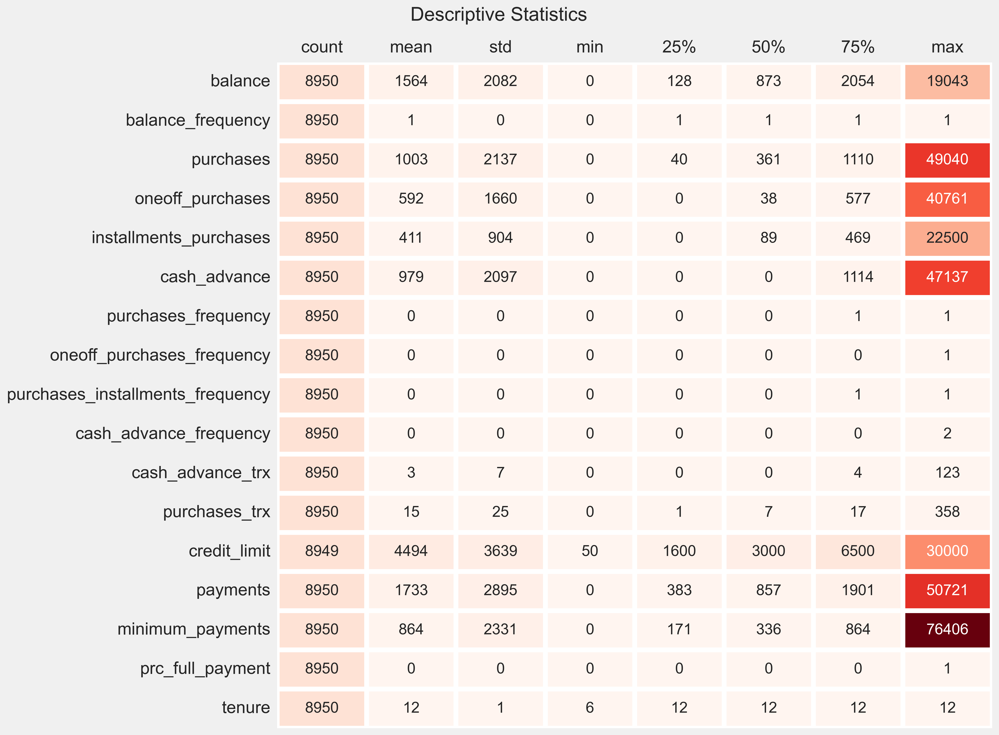

In [218]:
desc_cust = df.select_dtypes(include=['int64','float64']).describe().T
desc_cust_df = pd.DataFrame(index=desc_cust.index, columns=desc_cust.columns, data=desc_cust )

f,ax = plt.subplots(figsize=(12,12),dpi=500)

sns.heatmap(desc_cust_df, annot=True,cmap = "Reds", fmt= '.0f',
            ax=ax,linewidths = 5, cbar = False,
            annot_kws={"size": 16})

ax.xaxis.set_ticks_position('top')
plt.tick_params(left=False, top=False)
plt.xticks(size = 18)
plt.yticks(size = 18)
plt.title("Descriptive Statistics", pad=30, x=0.31, y=1.02)
plt.show()

In [219]:
desc_cust1 = df1[df1.minimum_payments.isna()].describe().T
desc_cust1

,count,mean,std,min,25%,50%,75%,max
balance,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
balance_frequency,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
purchases,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
oneoff_purchases,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
installments_purchases,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cash_advance,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
purchases_frequency,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
oneoff_purchases_frequency,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
purchases_installments_frequency,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cash_advance_frequency,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


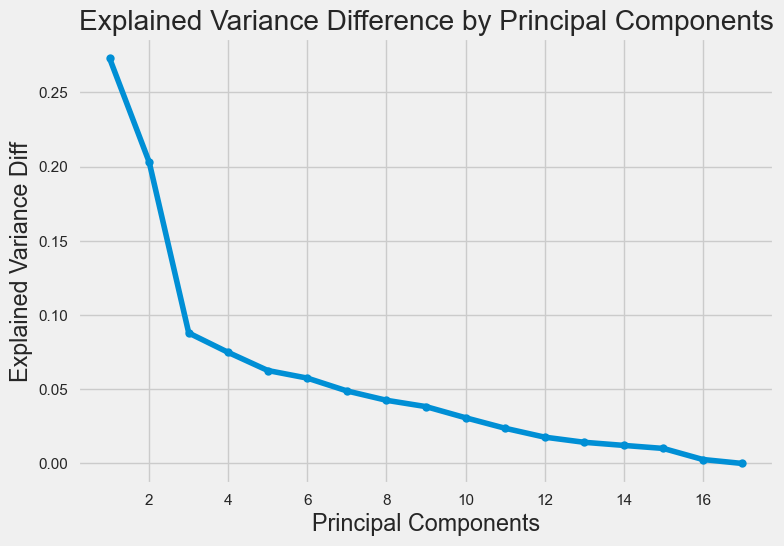

In [221]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'df' containing the specified columns
selected_columns = ['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
                    'installments_purchases', 'cash_advance', 'purchases_frequency',
                    'oneoff_purchases_frequency', 'purchases_installments_frequency',
                    'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
                    'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
                    'tenure']

# Extract the selected columns
data = df1[selected_columns]

# Standardize the data
scaler = StandardScaler()
data_standardized = scaler.fit_transform(data)

# Create a PCA instance
pca = PCA()

# Fit the PCA model to the standardized data
pca.fit(data_standardized)

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_

# Plot the explained variance ratio
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Diff')
plt.title('Explained Variance Difference by Principal Components')
plt.show()

# Determine the number of principal components to retain
n_components_to_retain = 5  # Choose an appropriate number based on the explained variance plot

# Perform PCA with the selected number of components
pca = PCA(n_components=n_components_to_retain)
principal_components = pca.fit_transform(data_standardized)

# Create a DataFrame with the principal components
principal_df = pd.DataFrame(data=principal_components, columns=[f'PC{i+1}' for i in range(n_components_to_retain)])

# Now 'principal_df' contains the principal components


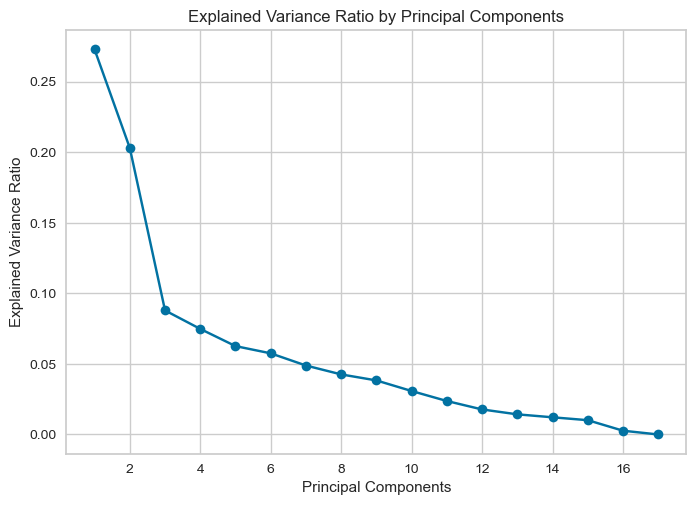

In [21]:
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Assuming you have a DataFrame named 'df' containing the specified columns
selected_columns = ['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
                    'installments_purchases', 'cash_advance', 'purchases_frequency',
                    'oneoff_purchases_frequency', 'purchases_installments_frequency',
                    'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
                    'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
                    'tenure']

# Extract the selected columns
data = df1[selected_columns]

# Standardize the data
scaler = StandardScaler()
data_standardized = scaler.fit_transform(data)

# Create a PCA instance
pca = PCA()

# Fit the PCA model to the standardized data
pca.fit(data_standardized)

# Explained variance ratio
explained_variance = pca.explained_variance_ratio_

# Plot the explained variance ratio
plt.plot(range(1, len(explained_variance) + 1), explained_variance, marker='o')
plt.xlabel('Principal Components')
plt.ylabel('Explained Variance Ratio')
plt.title('Explained Variance Ratio by Principal Components')
plt.show()

# Determine the number of principal components to retain
n_components_to_retain = 5  # Choose an appropriate number based on the explained variance plot

# Perform PCA with the selected number of components
pca = PCA(n_components=n_components_to_retain)
principal_components = pca.fit_transform(data_standardized)

# Create a DataFrame with the principal components
principal_df = pd.DataFrame(data=principal_components, columns=[f'PC{i+1}' for i in range(n_components_to_retain)])

# Now 'principal_df' contains the principal components


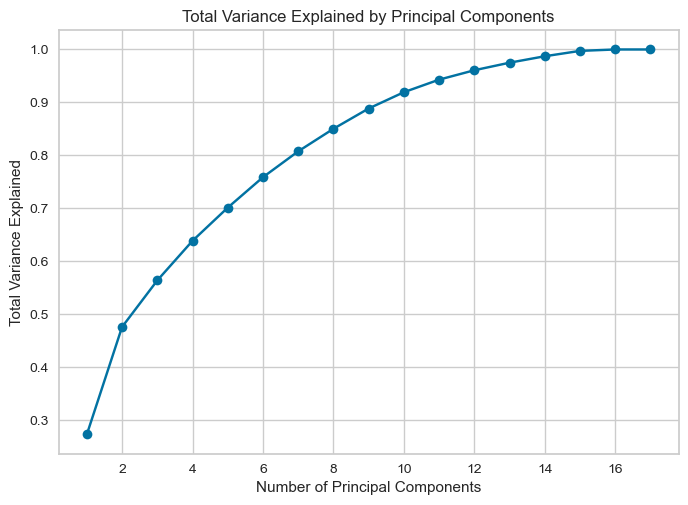

In [22]:
selected_columns = ['balance', 'balance_frequency', 'purchases', 'oneoff_purchases',
                    'installments_purchases', 'cash_advance', 'purchases_frequency',
                    'oneoff_purchases_frequency', 'purchases_installments_frequency',
                    'cash_advance_frequency', 'cash_advance_trx', 'purchases_trx',
                    'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment',
                    'tenure']

# Extract the selected columns
data = df1[selected_columns]

# Standardize the data
scaler = StandardScaler()
data_standardized = scaler.fit_transform(data)

# Create lists to store variance at each step
variance_explained = []

# Loop through PCA components and calculate variance at each step
for n_components in range(1, data.shape[1] + 1):
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(data_standardized)
    variance_explained.append(sum(pca.explained_variance_ratio_))

# Plot the variance explained at each step
plt.plot(range(1, data.shape[1] + 1), variance_explained, marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Total Variance Explained')
plt.title('Total Variance Explained by Principal Components')
plt.show()


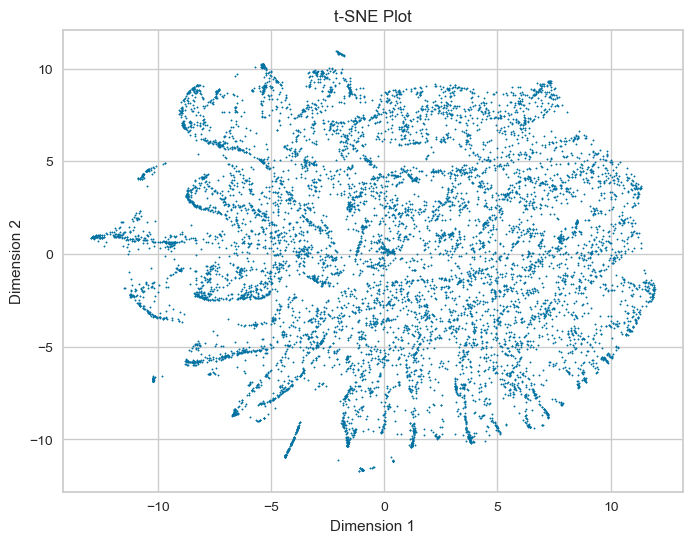

In [23]:
data = df1[selected_columns]

# Create a t-SNE instance
tsne = TSNE(n_components=2, perplexity=30, n_iter=300)

# Fit and transform the data using t-SNE
tsne_result = tsne.fit_transform(data)

# Create a DataFrame with the t-SNE results
tsne_df = pd.DataFrame(data=tsne_result, columns=['Dimension 1', 'Dimension 2'])

# Plot the t-SNE results
plt.figure(figsize=(8, 6))
plt.scatter(tsne_df['Dimension 1'], tsne_df['Dimension 2'],marker='.',s=4)
plt.title('t-SNE Plot')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.show()

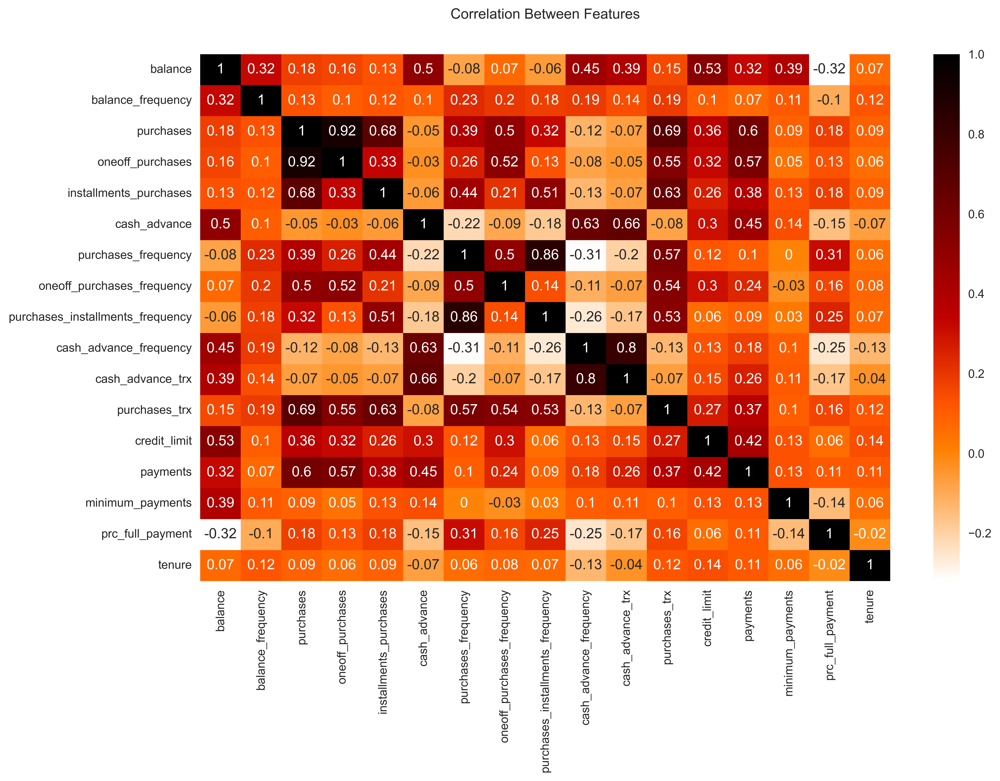

In [24]:
plt.figure(figsize=(13,8), dpi=500)
sns.heatmap(round(df.corr(),2), annot=True, cmap='gist_heat_r')
plt.title("Correlation Between Features", pad=30)
plt.show()

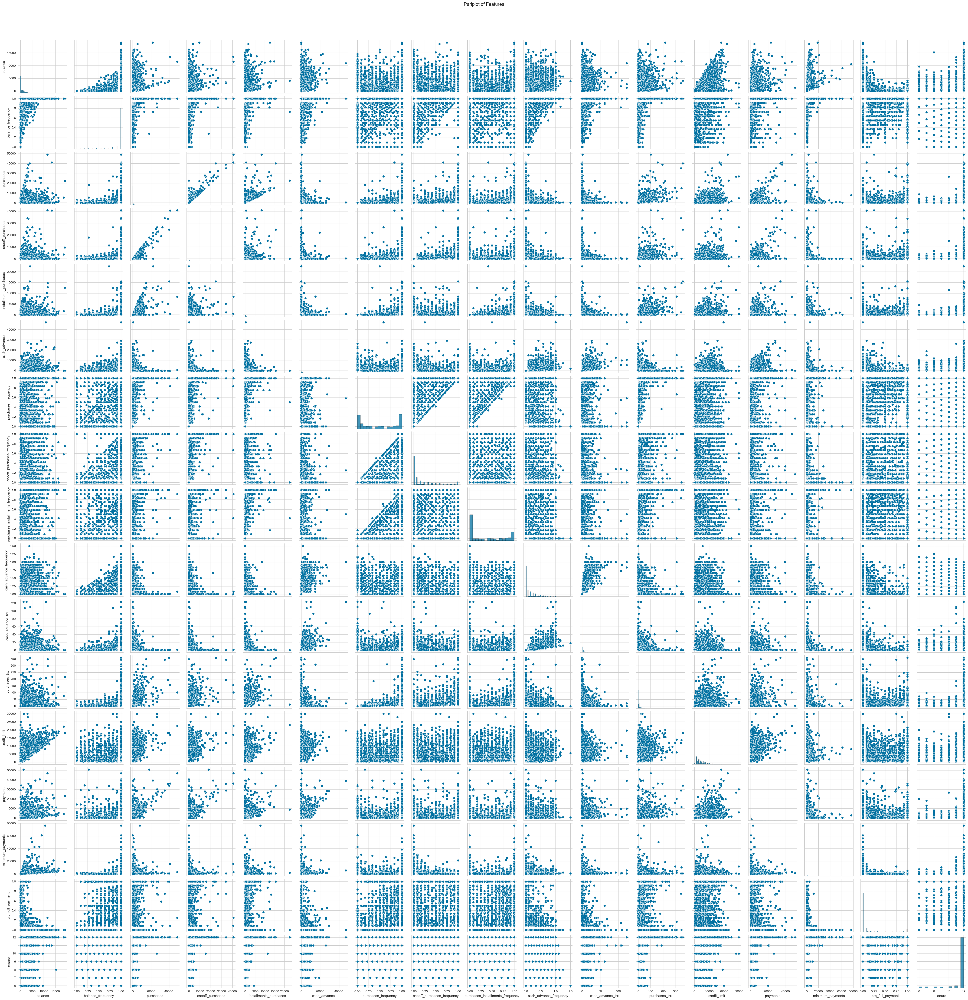

In [25]:
pplot = sns.pairplot(df1, palette="blue")
pplot.fig.suptitle("Pariplot of Features", y=1.02)
pplot.tight_layout()
plt.show()

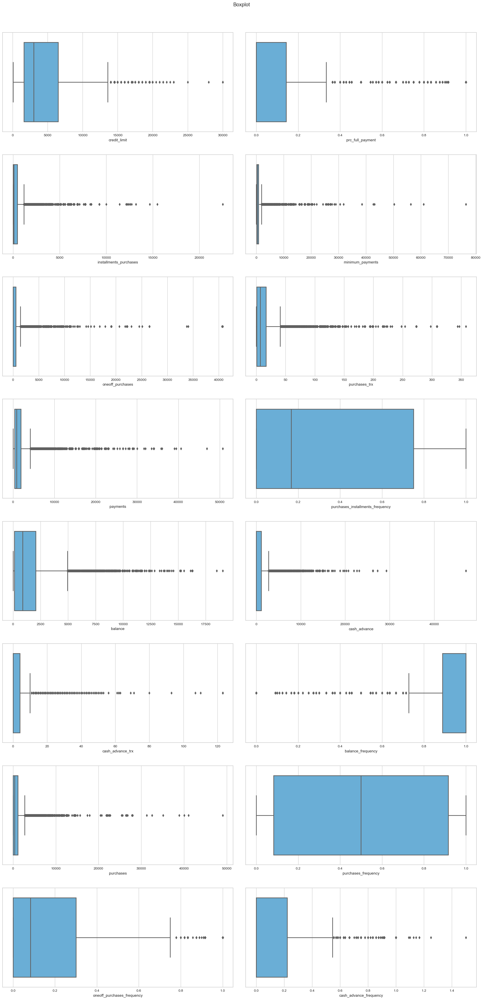

In [26]:
fig ,ax = plt.subplots(8,2,figsize=(20,40))
for i, col in enumerate(set(df1.columns)-set(['tenure'])):
    sns.boxplot(data=df1, x=col, palette="Blues", saturation=1, linewidth = 2, ax=ax[i//2, i%2])
plt.suptitle("Boxplot", y=1)
plt.tight_layout(pad=3.0)
plt.show()

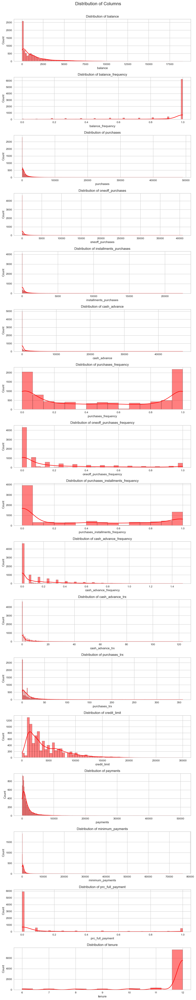

In [27]:
fig, ax = plt.subplots(17, 1, figsize=(10, 50))

# Loop through the columns and create histograms
for i, col in enumerate(df1.columns):
    sns.histplot(df1[col], kde=True, ax=ax[i], color='red')
    ax[i].set_title(f'Distribution of {col}', fontsize=12)

# Set a common title for all subplots
fig.suptitle('Distribution of Columns', y=1.002, fontsize=16)

# Adjust layout to prevent overlap
fig.tight_layout()

# Show the plot
plt.show()

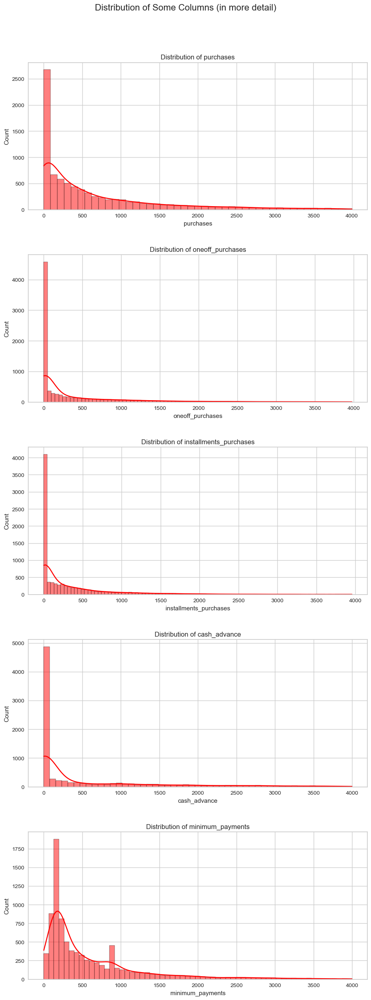

In [28]:
cols = ['purchases', 'oneoff_purchases', 'installments_purchases', 'cash_advance', 'minimum_payments']

# Create subplots
fig, ax = plt.subplots(5, 1, figsize=(10, 25))

# Loop through the specified columns and create limited range histograms
for i, col in enumerate(cols):
    sns.histplot(df1[df1[col] < 4000][col], kde=True, ax=ax[i], color='red')
    ax[i].set_title(f'Distribution of {col}', fontsize=12)

# Set a common title for all subplots
fig.suptitle('Distribution of Some Columns (in more detail)', y=1.002, fontsize=16)

# Adjust layout with additional padding
fig.tight_layout(pad=3)

# Show the plot
plt.show()

In [29]:
import plotly.express as px

# Assuming your dataframe is named df
fig = px.scatter_3d(df, x='tenure', y='balance_frequency', z='purchases',
                    color='cash_advance', size='cash_advance',
                    labels={'balance': 'Balance', 'balance_frequency': 'Balance Frequency', 'purchases': 'Purchases'},
                    title='Interactive 3D Scatter Plot with Zoom')

# Enable 3D scatter plot zoom
fig.update_layout(scene=dict(
                    xaxis=dict(nticks=4, range=[df['tenure'].min(), df['tenure'].max()]),
                    yaxis=dict(nticks=4, range=[df['balance_frequency'].min(), df['balance_frequency'].max()]),
                    zaxis=dict(nticks=4, range=[df['purchases'].min(), df['purchases'].max()])
                ),
                updatemenus=[dict(type='buttons', showactive=False, buttons=[dict(label='Zoom In',
                                                                                        method='relayout',
                                                                                        args=['scene.camera.zoom', 0.8]),
                                                                          dict(label='Zoom Out',
                                                                                        method='relayout',
                                                                                        args=['scene.camera.zoom', 1.2])])])

# Show the plot
fig.show()


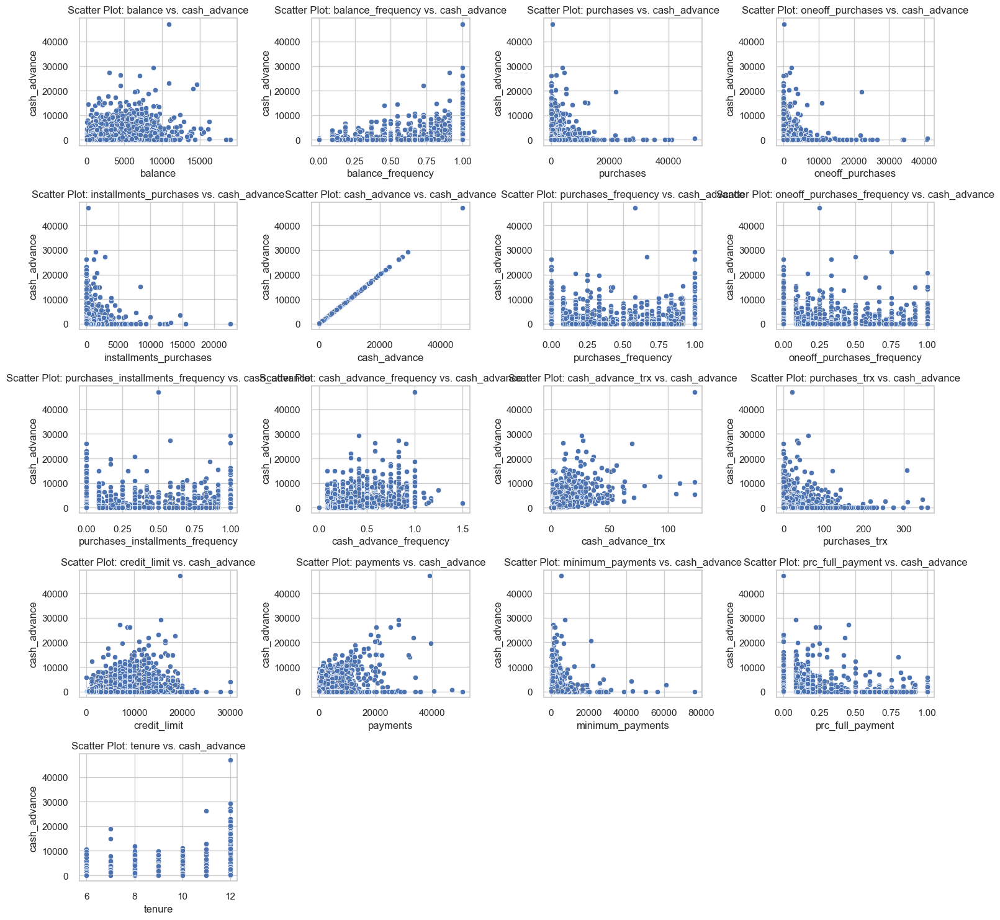

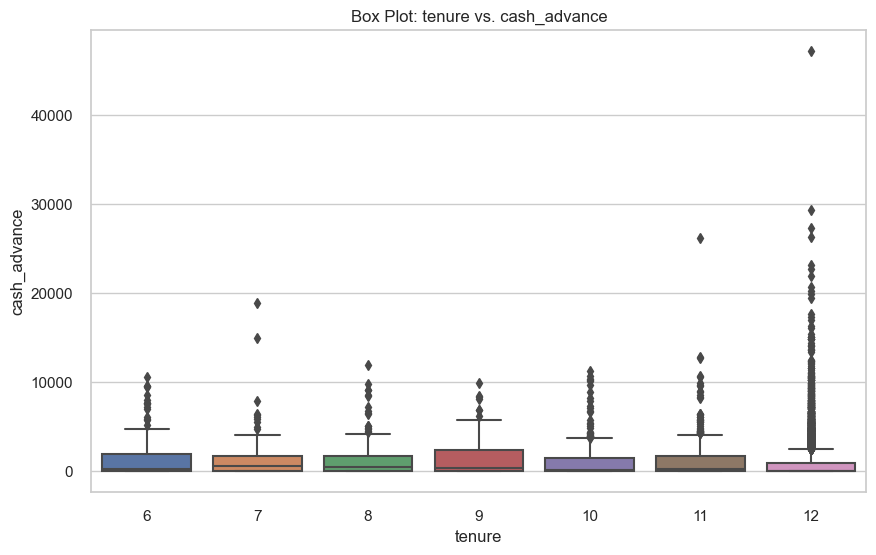

In [30]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your dataframe is named df
numerical_columns = ['balance', 'balance_frequency', 'purchases', 'oneoff_purchases', 'installments_purchases',
                      'cash_advance', 'purchases_frequency', 'oneoff_purchases_frequency',
                      'purchases_installments_frequency', 'cash_advance_frequency', 'cash_advance_trx',
                      'purchases_trx', 'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment', 'tenure']

# Scatter plots for numerical columns
sns.set(style="whitegrid")
plt.figure(figsize=(15, 15))
for i, col in enumerate(numerical_columns):
    plt.subplot(5, 4, i+1)
    sns.scatterplot(x=col, y='cash_advance', data=df)
    plt.title(f'Scatter Plot: {col} vs. cash_advance')

plt.tight_layout()
plt.show()

# Box plot for categorical column 'tenure'
plt.figure(figsize=(10, 6))
sns.boxplot(x='tenure', y='cash_advance', data=df)
plt.title('Box Plot: tenure vs. cash_advance')
plt.show()


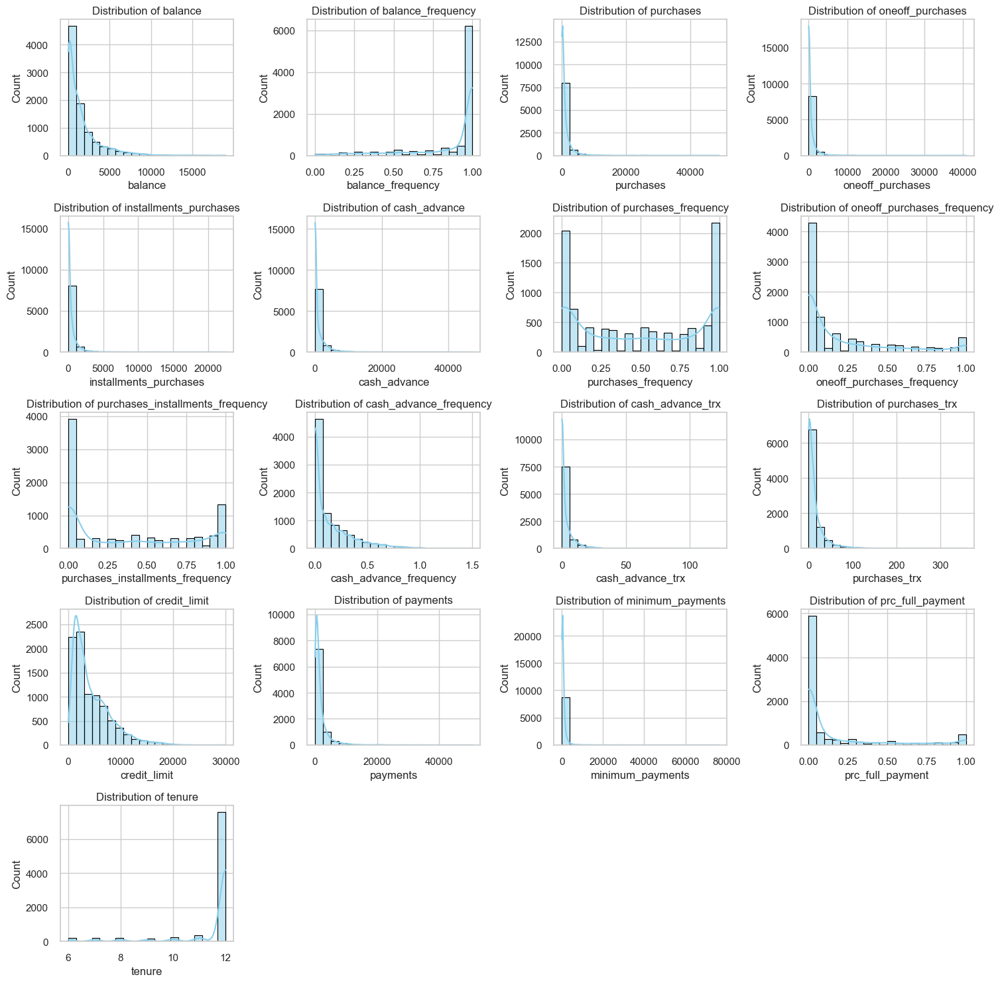

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming your dataframe is named df
numerical_columns = ['balance', 'balance_frequency', 'purchases', 'oneoff_purchases', 'installments_purchases',
                      'cash_advance', 'purchases_frequency', 'oneoff_purchases_frequency',
                      'purchases_installments_frequency', 'cash_advance_frequency', 'cash_advance_trx',
                      'purchases_trx', 'credit_limit', 'payments', 'minimum_payments', 'prc_full_payment', 'tenure']

# Set the style
sns.set(style="whitegrid")

# Create subplots for each numerical variable
plt.figure(figsize=(15, 15))
for i, col in enumerate(numerical_columns):
    plt.subplot(5, 4, i+1)
    sns.histplot(df[col], kde=True, bins=20, color='skyblue', edgecolor='black')
    plt.title(f'Distribution of {col}')

plt.tight_layout()
plt.show()

In [32]:
import plotly.express as px

# Assuming your dataframe is named df
fig = px.scatter_3d(df, x='tenure', y='balance_frequency', z='purchases',
                    color='cash_advance', size='cash_advance',
                    labels={'balance': 'Balance', 'balance_frequency': 'Balance Frequency', 'purchases': 'Purchases'},
                    title='Interactive 3D Scatter Plot with Zoom')

# Enable 3D scatter plot zoom
fig.update_layout(scene=dict(
                    xaxis=dict(nticks=4, range=[df['tenure'].min(), df['tenure'].max()]),
                    yaxis=dict(nticks=4, range=[df['balance_frequency'].min(), df['balance_frequency'].max()]),
                    zaxis=dict(nticks=4, range=[df['purchases'].min(), df['purchases'].max()])
                ))

# Show the plot
fig.show()


In [33]:
scaler = StandardScaler().fit(df1)
df_trans = scaler.transform(df1)
df2 = pd.DataFrame(df_trans, columns = df1.columns)
df2

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,-0.732054,-0.249881,-0.424934,-0.356957,-0.349114,-0.466805,-0.806649,-0.678716,-0.707409,-0.675294,-0.476083,-0.511381,-0.960380,-0.529026,-0.310993,-0.525588,0.360541
1,0.786858,0.134049,-0.469584,-0.356957,-0.454607,2.605438,-1.221928,-0.678716,-0.917090,0.573949,0.110032,-0.591841,0.688601,0.818546,0.089265,0.234159,0.360541
2,0.447041,0.517980,-0.107716,0.108843,-0.454607,-0.466805,1.269742,2.673295,-0.917090,-0.675294,-0.476083,-0.109082,0.826016,-0.383857,-0.101699,-0.525588,0.360541
3,0.049015,-1.017743,0.231995,0.546123,-0.454607,-0.368678,-1.014290,-0.399383,-0.917090,-0.258882,-0.329554,-0.551611,0.826016,-0.598733,-0.000041,-0.525588,0.360541
4,-0.358849,0.517980,-0.462095,-0.347317,-0.454607,-0.466805,-1.014290,-0.399383,-0.917090,-0.675294,-0.476083,-0.551611,-0.905414,-0.364421,-0.265819,-0.525588,0.360541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,-0.738015,0.517980,-0.333331,-0.356957,-0.132688,-0.466805,1.269742,-0.678716,1.179720,-0.675294,-0.476083,-0.350461,-0.960380,-0.486266,-0.349878,1.183844,-4.126919
8945,-0.742488,0.517980,-0.329174,-0.356957,-0.122869,-0.466805,1.269742,-0.678716,1.179720,-0.675294,-0.476083,-0.350461,-0.960380,-0.503445,-0.000041,-0.525588,-4.126919
8946,-0.740463,-0.185895,-0.402000,-0.356957,-0.294930,-0.466805,0.854463,-0.678716,0.760359,-0.675294,-0.476083,-0.390691,-0.960380,-0.570660,-0.335490,0.329128,-4.126919
8947,-0.745239,-0.185895,-0.469584,-0.356957,-0.454607,-0.449373,-1.221928,-0.678716,-0.917090,0.157536,-0.183026,-0.591841,-1.097795,-0.580581,-0.346930,0.329128,-4.126919


In [134]:
kmeans_set = {"init":"random", "n_init":10, "max_iter":300, "random_state":42}
# Find inertia for k cluster
inertias = []
for k in range(1,11):
    kmeans = KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(df2)
    inertias.append(kmeans.inertia_)

In [135]:
inertias

[152133.00000000006,
 127772.88291109548,
 111974.94761548913,
 99065.82208709336,
 91495.15745340046,
 84845.63301489328,
 79877.0460121195,
 75199.13354634584,
 70903.02329419735,
 66471.21217489208]

In [136]:
def elbow_optimizer(inertias,name):
    """ Find optimom k for clustering algorithm
        inertias (list): list that has inertia for each selected k
        name (string): name of clustering algorithm
    """

    kl = KneeLocator(range(1,11), inertias, curve='convex', direction="decreasing")
    plt.style.use("fivethirtyeight")
    sns.lineplot(x=range(1,11), y=inertias)
    plt.xticks(range(1,11))
    plt.xlabel("Number of Clusters", labelpad=20)
    plt.ylabel("Inertia", labelpad=20)
    plt.title(f"Elbow Method for {name}", y=1.09)
    plt.axvline(x=kl.elbow, label='axvline-fullheight', ls='--')
    plt.show()

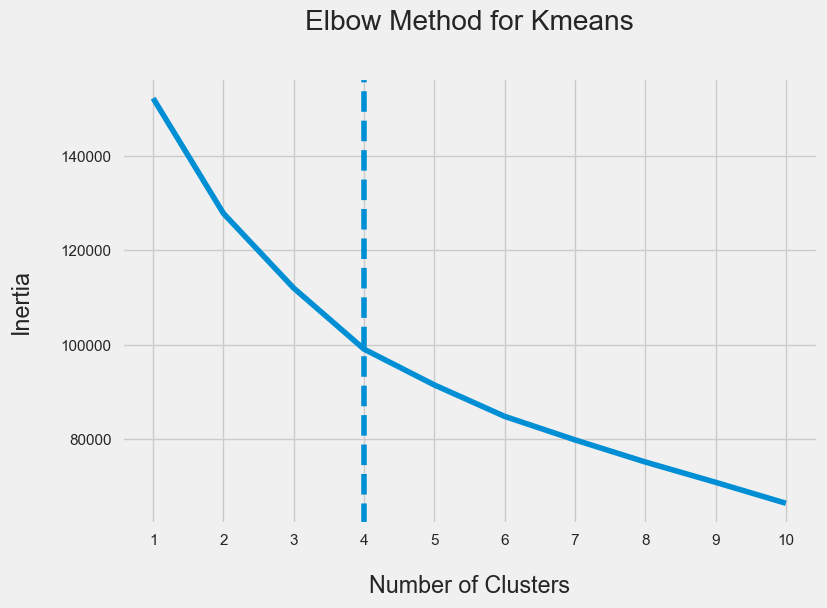

In [137]:
elbow_optimizer(inertias, 'Kmeans')

In [141]:
# Calculate silhouette_score and calinski_harabasz_score
silhouette_coef = []
for k in range(2,11):
    kmeans = KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(df2)
    score = silhouette_score(df2, kmeans.labels_)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(2,11):
    kmeans = KMeans(n_clusters=k, **kmeans_set)
    kmeans.fit(df2)
    score = calinski_harabasz_score(df2, kmeans.labels_)
    calinski_harabasz_coef.append(score)

In [142]:
def plot_evaluation(sh_score, ch_score, name, x=range(2,11)):
   
    
    fig, ax = plt.subplots(1,2,figsize=(15,7), dpi=100)
    ax[0].plot(x, sh_score, marker='o', ms=9)
    ax[1].plot(x, ch_score, marker='o', ms=9)
    ax[0].set_xlabel("Number of Clusters", labelpad=20)
    ax[0].set_ylabel("Silhouette Coefficient", labelpad=20)
    ax[1].set_xlabel("Number of Clusters", labelpad=20)
    ax[1].set_ylabel("calinski Harabasz Coefficient", labelpad=20)
    plt.suptitle(f'Evaluate {name} Clustering',y=0.9)
    plt.tight_layout(pad=3)
    plt.show()

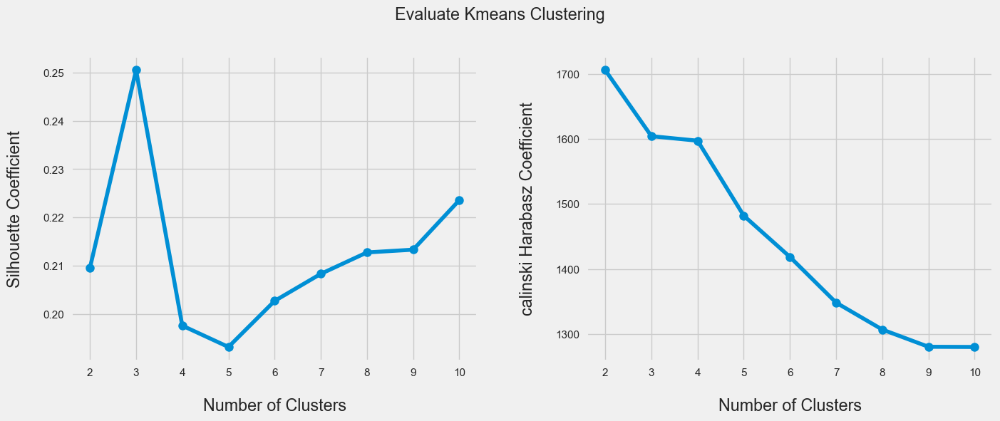

In [143]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Kmeans')


In [144]:
best_model = pd.DataFrame({'Model':[], 'Sil_score':[], 'CH_score':[], 'setting':[]})

In [145]:
# Implement kmeans for n_clusters=3
kmeans = KMeans(n_clusters=3, **kmeans_set).fit(df2)
# Store result of kmeans
pred = kmeans.labels_
# Store the coordinates of centroids
centroids = kmeans.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns = [df2.columns])
centroids.T

,0,1,2
balance,-0.367482,0.320182,1.161351
balance_frequency,-0.177389,0.439690,0.340142
purchases,-0.232732,1.529768,-0.290503
oneoff_purchases,-0.204323,1.281537,-0.207498
installments_purchases,-0.174812,1.262273,-0.305746
cash_advance,-0.309578,-0.246823,1.377750
purchases_frequency,-0.062309,1.142795,-0.644699
oneoff_purchases_frequency,-0.234768,1.561439,-0.307186
purchases_installments_frequency,-0.047926,0.956401,-0.555728
cash_advance_frequency,-0.334339,-0.358474,1.559010


In [146]:
# Store resluts of kmeans
best_model.loc[len(best_model.index)] = [
    f"Kmeans",
    silhouette_score(df2, pred),
    calinski_harabasz_score(df2, pred),
    {"n_clusters":3, **kmeans_set}]

In [147]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250521,1604.176695,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."


In [148]:
# Transmition slaced centroids to real
real_centroids = scaler.inverse_transform(centroids)
real_centroids = pd.DataFrame(data=real_centroids, columns = [df2.columns])
real_centroids.T

,0,1,2
balance,799.746466,2231.096018,3981.961277
balance_frequency,0.835347,0.981462,0.957891
purchases,506.058849,4271.831475,382.624762
oneoff_purchases,253.353319,2719.695762,248.083296
installments_purchases,253.026328,1552.621937,134.618954
cash_advance,329.728883,461.334415,3868.303195
purchases_frequency,0.465398,0.949052,0.231664
oneoff_purchases_frequency,0.132442,0.668302,0.110838
purchases_installments_frequency,0.345431,0.744580,0.143616
cash_advance_frequency,0.068232,0.063402,0.447132


In [155]:
# Adding the clusters column to the main dataframe (df2) and store in new dataframe
df_result_kmeans = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_kmeans[:-1]

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure,cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0.0
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,2.0
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0.0
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,864.206542,0.000000,12.0,0.0
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8946,19.183215,1.000000,300.00,0.00,300.0,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,864.206542,0.000000,6.0,0.0
8947,23.398673,0.833333,144.40,0.00,144.4,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0.0
8948,13.457564,0.833333,0.00,0.00,0.0,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0.0
8949,372.708075,0.666667,1093.25,1093.25,0.0,127.040008,0.666667,0.666667,0.000000,0.333333,2.0,23.0,1200.0,63.165404,88.288956,0.000000,6.0,NaN


In [157]:
# Overview of resluts
def check_result(data):

    fig, axes = plt.subplots(1,2,figsize=(10,4))
    # Count of cluster (countplot)
    sns.countplot(data=data, x='cluster', ax=axes[0], saturation=1, edgecolor = "#1c1c1c", linewidth = 2)
    for container in axes[0].containers:
        axes[0].bar_label(container, label_type="center", padding=5, size=12, color="black", rotation=0,
        bbox={"boxstyle": "round", "pad": 0.4, "facecolor": "#e0b583", "edgecolor": "#1c1c1c", "linewidth" : 2, "alpha": 1})
    # Draw pie plot
    slices = data['cluster'].value_counts().sort_index().values
    activities = [var for var in data['cluster'].value_counts().sort_index().index]
    wedges, texts, autotexts = axes[1].pie(
        slices,
        labels=activities,
        shadow=True,
        autopct='%1.1f%%',
        textprops=dict(size=16, color="black"),
        pctdistance = 0.6,
        radius=1, 
        wedgeprops=dict(edgecolor = "black", linewidth = 2),)

    plt.legend(
        wedges, 
        data.cluster.value_counts().sort_index().index, 
        title="Clusters",
        loc="center left",
        bbox_to_anchor=(1, 0, 0.5, 1),
        edgecolor = "black")


    plt.suptitle(f'Count of Each Cluster', y=1.09)
    plt.show()

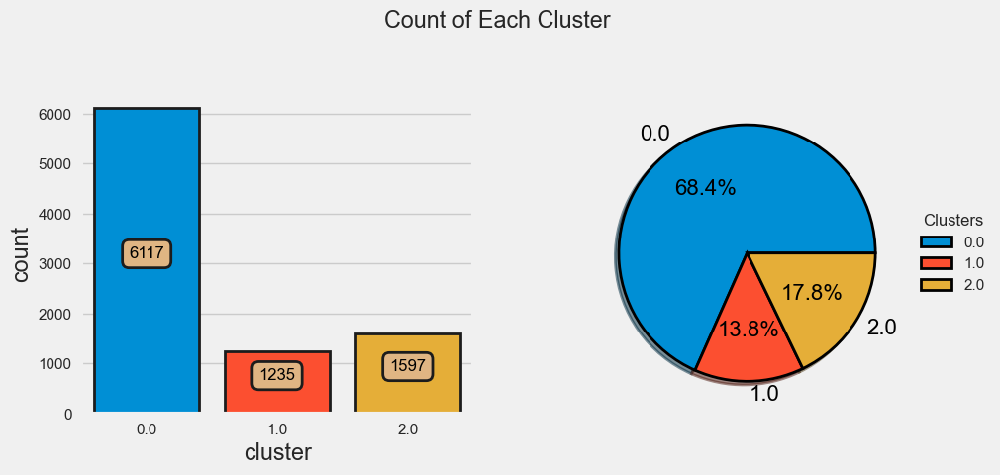

In [158]:
check_result(df_result_kmeans)

In [159]:
inertias = []
for k in range(1,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(df2)
    inertias.append(mbkmeans.inertia_)

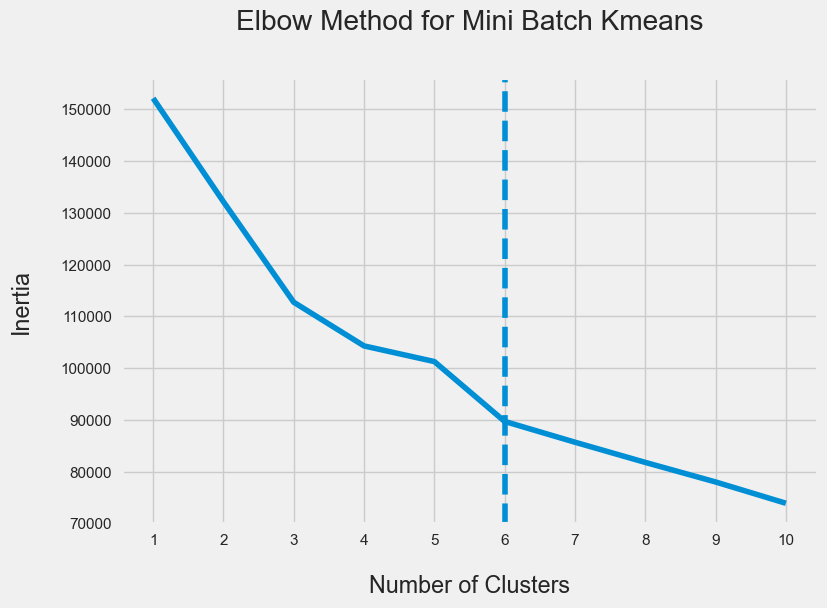

In [160]:
elbow_optimizer(inertias, 'Mini Batch Kmeans')

In [161]:
# Calculate silhouette_score and calinski_harabasz_score
silhouette_coef = []
for k in range(2,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(df2)
    score = silhouette_score(df2, mbkmeans.labels_)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(2,11):
    mbkmeans = MiniBatchKMeans(n_clusters=k, random_state=42)
    mbkmeans.fit(df2)
    score = calinski_harabasz_score(df2, mbkmeans.labels_)
    calinski_harabasz_coef.append(score)

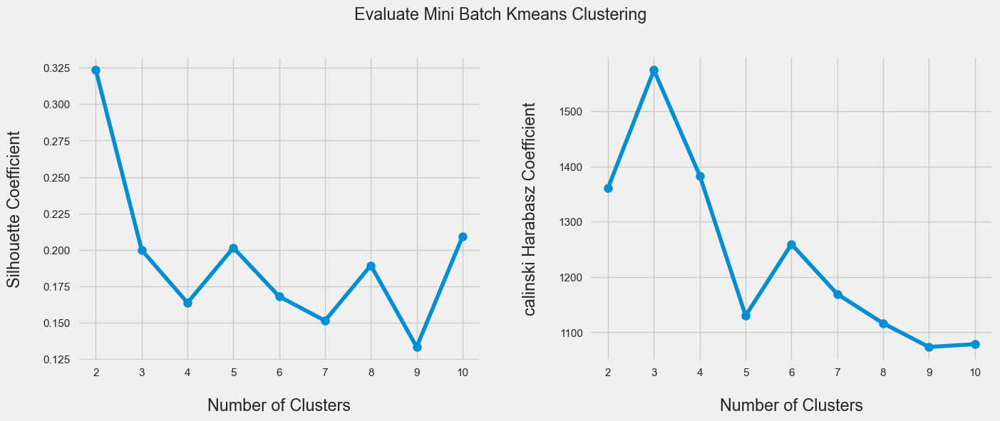

In [162]:
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Mini Batch Kmeans')

In [163]:
# Implement MiniBatchKmeans algorithm
mbkmeans = MiniBatchKMeans(n_clusters=3, random_state=42).fit(df2)
# Store result of mini batch kmeans
pred = mbkmeans.labels_
# Store the coordinates of centroids
centroids = mbkmeans.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns = [df2.columns])
centroids.T

,0,1,2
balance,0.766415,0.410789,-0.448548
balance_frequency,0.318977,0.457280,-0.224537
purchases,-0.282635,1.812178,-0.177596
oneoff_purchases,-0.191053,1.480185,-0.175677
installments_purchases,-0.317346,1.565345,-0.097145
cash_advance,0.818552,-0.163882,-0.384872
purchases_frequency,-0.621489,1.168162,0.129886
oneoff_purchases_frequency,-0.235283,1.688566,-0.167326
purchases_installments_frequency,-0.568502,1.005412,0.127699
cash_advance_frequency,1.107723,-0.320033,-0.486569


In [164]:
# Store results obtained from MiniBatchKmeans
best_model.loc[len(best_model.index)] = [
    f"Mini Batch Kmeans",
    silhouette_score(df2, pred),
    calinski_harabasz_score(df2, pred),
    {"n_clusters":3, "random_state":42}]

In [165]:
# Transmition slaced centroids to real
real_centroids = scaler.inverse_transform(centroids)
real_centroids = pd.DataFrame(data=real_centroids, columns = [df2.columns])
real_centroids.T

,0,1,2
balance,3159.915892,2419.691132,631.009391
balance_frequency,0.952879,0.985627,0.824183
purchases,399.436961,4875.232703,623.862850
oneoff_purchases,275.379148,3049.428109,300.901213
installments_purchases,124.128734,1826.698116,323.262814
cash_advance,2695.584317,635.274794,171.826192
purchases_frequency,0.240979,0.959232,0.542533
oneoff_purchases_frequency,0.132289,0.706228,0.152562
purchases_installments_frequency,0.138539,0.764058,0.415229
cash_advance_frequency,0.356819,0.071095,0.037768


In [166]:
df_result_mbkmeans = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_mbkmeans[:-1]

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,2.0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0.0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,2.0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,864.206542,0.000000,12.0,2.0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,2.0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,864.206542,0.000000,6.0,2.0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,2.0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,2.0


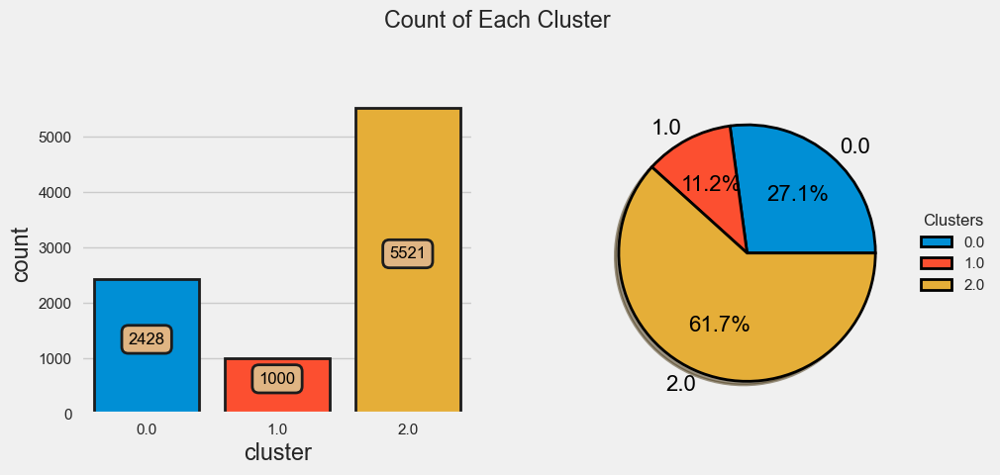

In [167]:
check_result(df_result_mbkmeans)

In [168]:
# The following bandwidth can be automatically detected using
bandwidth = estimate_bandwidth(df2, n_samples=10, n_jobs=-1)
bandwidth

3.0354014680388843

In [169]:
# Implement mean shift with the bandwidth obtained from estimate_bandwidth
m_shift = MeanShift(bandwidth=bandwidth)
m_shift.fit(df2)
# Store result of mean shift
pred = m_shift.labels_
# Number of cluster
np.unique(pred)
# Evaluate results of mean shift by silhouette and calinski coefficient
sh_score = silhouette_score(df2, pred)
ch_score = calinski_harabasz_score(df2, pred)
# Print results
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))
print(colored(f"Silhouette Coefficient: {sh_score}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {ch_score}", 'red'))

Number of cluster: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176]
Silhouette Coefficient: 0.13000862482220443
Calinski Harabasz Coefficient: 48.98908090664059


In [170]:
# Find optimom bandwidth for implement mean shift by using silhouette and calinski coefficient
silhouette_coef = []
for k in range(10,16,2):
    m_shift = MeanShift(bandwidth=k)
    m_shift.fit(df2)
    score = silhouette_score(df2, m_shift.labels_)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(10,16,2):
    m_shift = MeanShift(bandwidth=k)
    m_shift.fit(df2)
    score = calinski_harabasz_score(df2, m_shift.labels_)
    calinski_harabasz_coef.append(score)


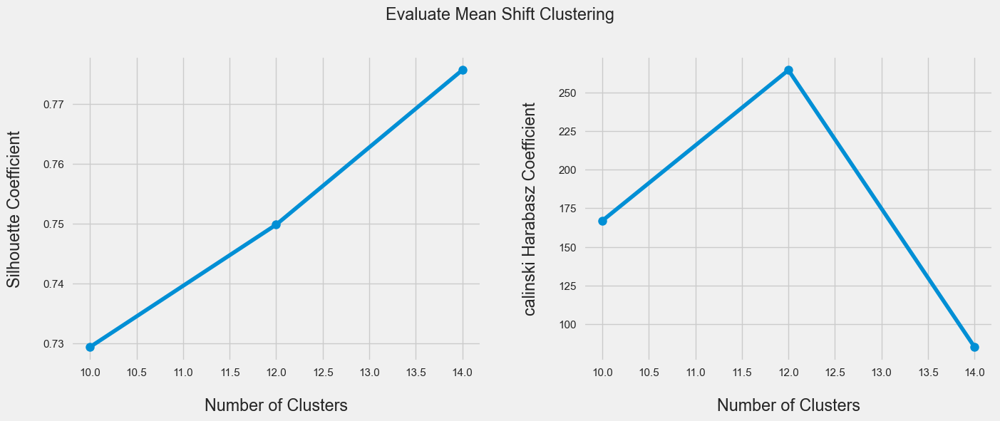

In [62]:
# Draw plots of silhouette_score and calinski_harabasz_score for MeanShift models
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Mean Shift', x=range(10,16,2))


In [171]:
# Implement mean shift with the bandwidth=12
m_shift = MeanShift(bandwidth=12)
m_shift.fit(df2)
# Store result of mean shift
pred = m_shift.labels_
# Number of cluster
np.unique(pred)
# Print results
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))

Number of cluster: [0 1 2 3 4]


In [172]:
# Store results obtained from Meanshift
best_model.loc[len(best_model.index)] = [
    f"Mean Shift",
    silhouette_score(df2, pred),
    calinski_harabasz_score(df2, pred),
    {"bandwidth":12}]

In [173]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250521,1604.176695,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mini Batch Kmeans,0.199886,1574.141345,"{'n_clusters': 3, 'random_state': 42}"
2,Mean Shift,0.749819,264.325131,{'bandwidth': 12}


In [65]:
centroids = m_shift.cluster_centers_
centroids = pd.DataFrame(data=centroids, columns = [df2.columns])
centroids.T

,0,1,2,3,4
balance,-0.018496,4.487413,4.327121,1.199184,1.175120
balance_frequency,-0.003054,0.517980,0.517980,-0.633812,0.517980
purchases,-0.047198,-0.267427,3.152736,10.061124,18.270728
oneoff_purchases,-0.041084,-0.276529,-0.356957,-0.356957,14.429400
installments_purchases,-0.036102,-0.124605,8.103663,24.425755,16.682091
cash_advance,-0.022235,22.010021,-0.466805,-0.466805,-0.466805
purchases_frequency,-0.004989,0.231545,1.269742,0.023907,1.269742
oneoff_purchases_frequency,-0.008716,0.159287,-0.678716,-0.678716,2.673295
purchases_installments_frequency,-0.005285,0.340997,1.599083,0.131316,1.599083
cash_advance_frequency,-0.005568,4.321680,-0.675294,-0.675294,-0.675294


In [66]:
# Transmition slaced centroids to real
centroids = scaler.inverse_transform(centroids)
centroids = pd.DataFrame(data = centroids, columns = [df2.columns])
centroids

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
0,1526.149655,0.876627,902.472646,524.30987,378.465767,932.329551,0.488403,0.19988,0.362377,0.134026,3.119319,13.964024,4422.987271,1587.148384,789.181270,0.152514,11.51483
1,10905.053810,1.000000,431.930000,133.50000,298.430000,47137.211760,0.583333,0.25000,0.500000,1.000000,123.000000,21.000000,19600.000000,39048.597620,5394.173671,0.000000,12.00000
2,10571.411070,1.000000,7739.480000,0.00000,7739.480000,0.000000,1.000000,0.00000,1.000000,0.000000,0.000000,44.000000,8000.000000,2688.447014,76406.207520,0.000000,12.00000
3,4060.710208,0.727273,22500.000000,0.00000,22500.000000,0.000000,0.500000,0.00000,0.416667,0.000000,0.000000,12.000000,23000.000000,8760.860264,1645.535202,0.000000,12.00000
4,4010.621974,1.000000,40040.710000,24543.52000,15497.190000,0.000000,1.000000,1.00000,1.000000,0.000000,0.000000,358.000000,18000.000000,33994.727850,703.503256,1.000000,12.00000


In [68]:
# Adding cluster column to dataframe
df_result_mshift = pd.concat([df1, pd.DataFrame({'cluster': pred})], axis = 1)
df_result_mshift[:-1]

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0.0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0.0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0.0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,864.206542,0.000000,12.0,0.0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0.0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,864.206542,0.000000,6.0,0.0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0.0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0.0


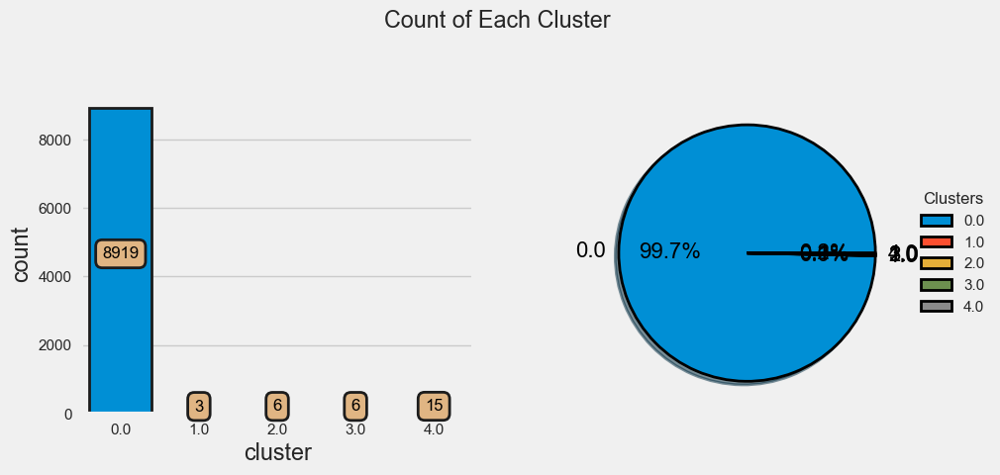

In [69]:
# Implement check_reuslts function for MeanShift model
check_result(df_result_mshift)

Elbow Method to determine the number of clusters to be formed:


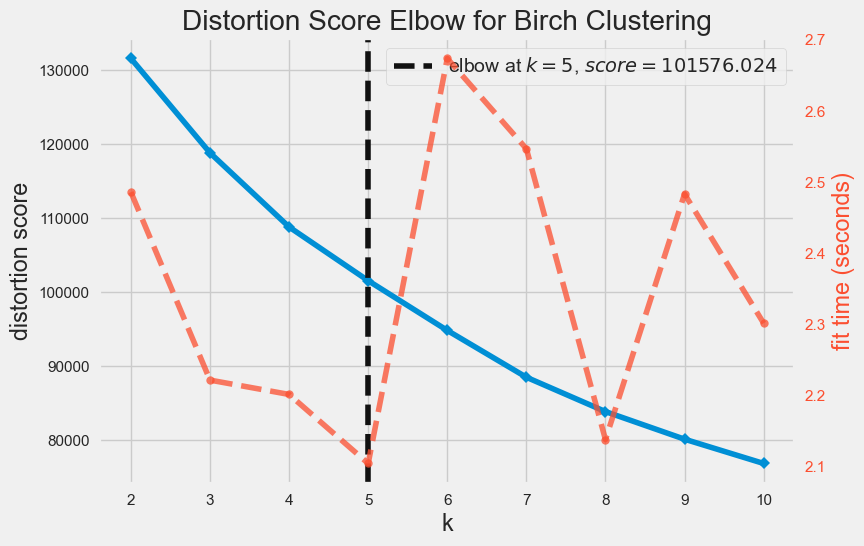

<Axes: title={'center': 'Distortion Score Elbow for Birch Clustering'}, xlabel='k', ylabel='distortion score'>

In [174]:
# Select optimom n_cluster for Birch
BP = Birch(threshold=0.0001)

# Quick examination of elbow method to find numbers of clusters to make.
print('Elbow Method to determine the number of clusters to be formed:')
Elbow_M = KElbowVisualizer(BP, k=10)
Elbow_M.fit(df2)
Elbow_M.show()

In [175]:
# Check optimom n_clusters for implement birch by using silhouette and calinski coefficient
silhouette_coef = []
for k in range(2,11):
    birch = Birch(n_clusters=k, threshold=0.0001)
    birch.fit(df2)
    score = silhouette_score(df2, birch.labels_)
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(2,11):
    birch = Birch(n_clusters=k, threshold=0.0001)
    birch.fit(df2)
    score = calinski_harabasz_score(df2, birch.labels_)
    calinski_harabasz_coef.append(score)

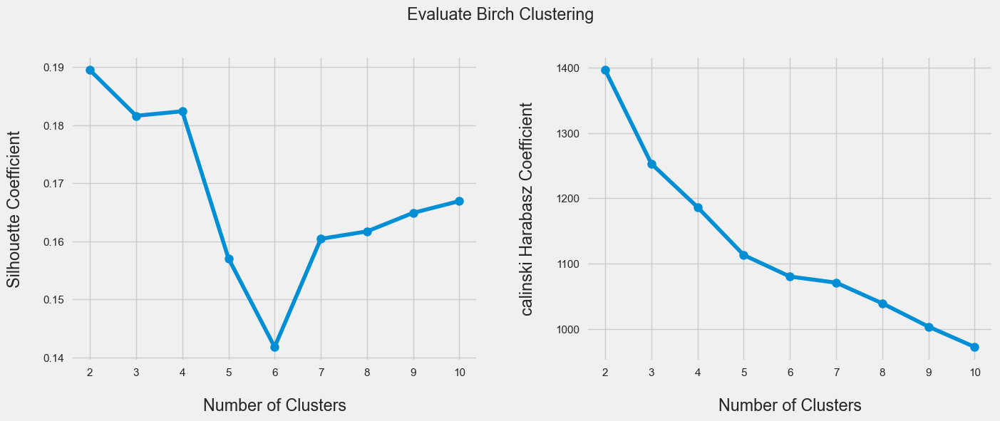

In [176]:
# Draw plots of silhouette_score and calinski_harabasz_score for Birch models
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Birch')

In [177]:
# Implement Birch algorithm
birch = Birch(n_clusters=2, threshold=0.0001)
birch.fit(df2)
# Store result of Birch
pred = birch.labels_

In [178]:
# Store results obtained from Birch
best_model.loc[len(best_model.index)] = [
    f"BIRCH",
    silhouette_score(df2, pred),
    calinski_harabasz_score(df2, pred),
    {"n_clusters":2, "threshold":0.0001}]

In [179]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250521,1604.176695,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mini Batch Kmeans,0.199886,1574.141345,"{'n_clusters': 3, 'random_state': 42}"
2,Mean Shift,0.749819,264.325131,{'bandwidth': 12}
3,BIRCH,0.189464,1396.264548,"{'n_clusters': 2, 'threshold': 0.0001}"


In [76]:
# Adding the clusters column to the main dataframe (df2) and store in new dataframe
df_result_birch = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_birch[:-1]

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0.0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0.0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0.0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,864.206542,0.000000,12.0,0.0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0.0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,864.206542,0.000000,6.0,0.0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0.0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0.0


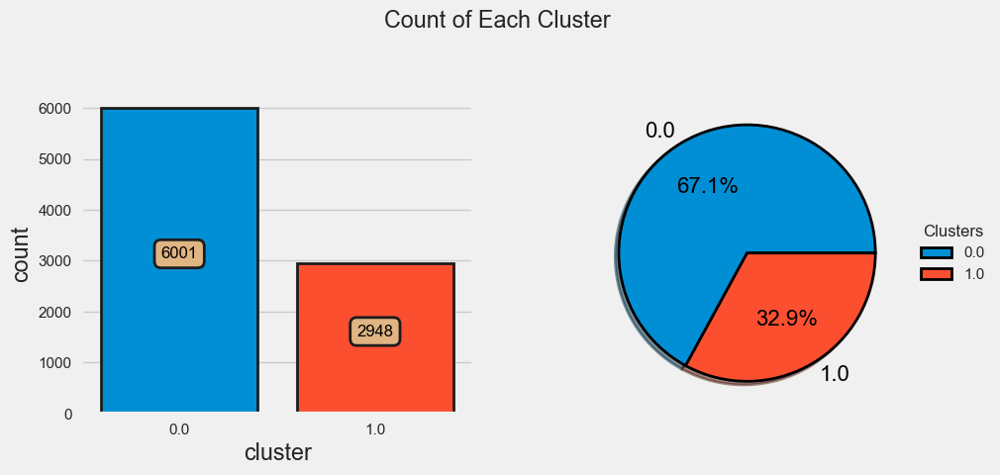

In [77]:
# Implement check_result function for Birch model
check_result(df_result_birch)

Text(0.5, 1.0, 'K-Distance Graph')

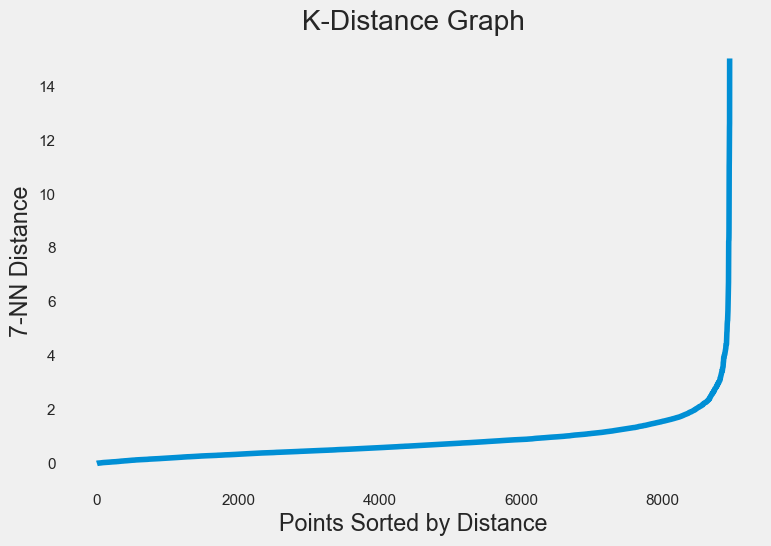

In [180]:
# Using NearestNeighbors fucntion for to guess the right value for eps
knn = NearestNeighbors(n_neighbors = 4)
model = knn.fit(df2)
distances, indices = knn.kneighbors(df2)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.grid()
plt.plot(distances);
plt.xlabel('Points Sorted by Distance')
plt.ylabel('7-NN Distance')
plt.title('K-Distance Graph')

In [181]:
# Finding best value for eps and min_sample
eps_values = np.arange(1,15,2) # eps values to be investigated
min_samples = np.arange(20,41,10) # min_samples values to be investigated

DBSCAN_params = list(product(eps_values, min_samples))

In [182]:
# Check optimom n_clusters for implement dbscan by using silhouette and calinski coefficient
silhouette_coef = []
num_of_clusters = []
for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = silhouette_score(df2, dbscan.labels_)
    silhouette_coef.append(score)
    # for check number of clusters
    num_of_clusters.append(len(np.unique(dbscan.labels_)))

calinski_harabasz_coef = []
for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = calinski_harabasz_score(df2, dbscan.labels_)
    calinski_harabasz_coef.append(score)


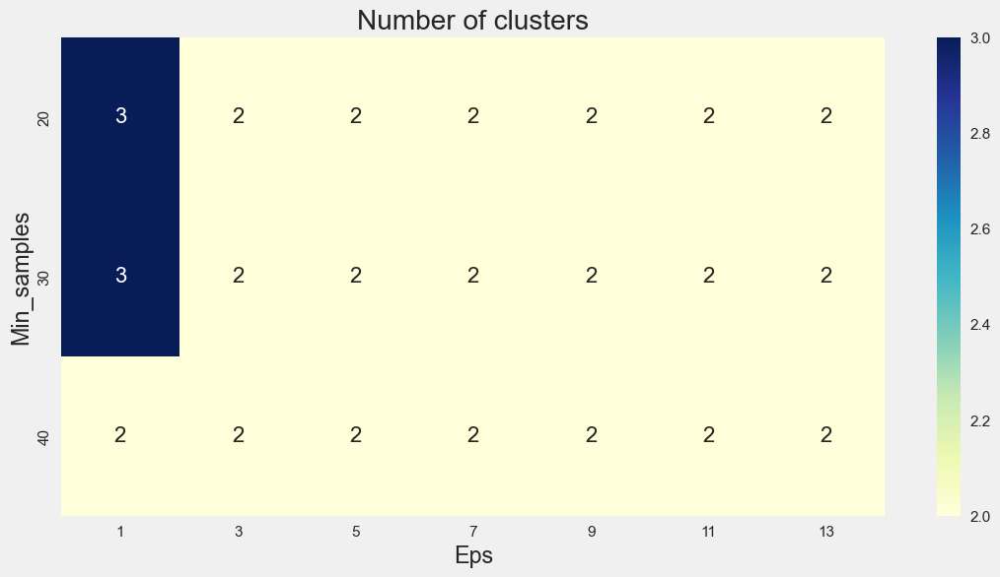

In [183]:
# Check cluster results by heatmap
tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])   
tmp['No_of_clusters'] = num_of_clusters

pivot_1 = pd.pivot_table(tmp, values='No_of_clusters', index='Min_samples', columns='Eps')

fig, ax = plt.subplots(figsize=(12,6))
sns.heatmap(pivot_1, annot=True,annot_kws={"size": 16}, cmap="YlGnBu", ax=ax)
ax.set_title('Number of clusters')
plt.show()

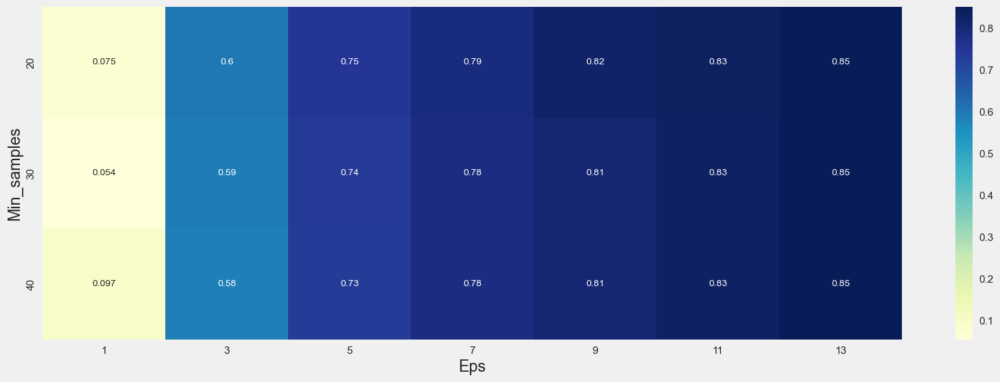

In [184]:
# Check silhouette score by heatmap
tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])   
tmp['Sil_score'] = silhouette_coef

pivot_1 = pd.pivot_table(tmp, values='Sil_score', index='Min_samples', columns='Eps')

fig, ax = plt.subplots(figsize=(18,6))
sns.heatmap(pivot_1, annot=True, annot_kws={"size": 10}, cmap="YlGnBu", ax=ax)
plt.show()

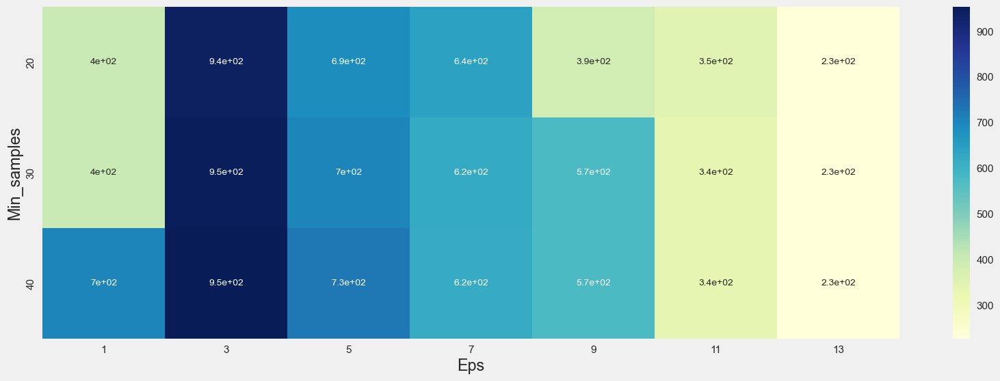

In [185]:
# Check Calinski score by heatmap
tmp = pd.DataFrame.from_records(DBSCAN_params, columns =['Eps', 'Min_samples'])   
tmp['CH_score'] = calinski_harabasz_coef

pivot_1 = pd.pivot_table(tmp, values='CH_score', index='Min_samples', columns='Eps')

fig, ax = plt.subplots(figsize=(18,6))
sns.heatmap(pivot_1, annot=True, annot_kws={"size": 10}, cmap="YlGnBu", ax=ax)
plt.show()

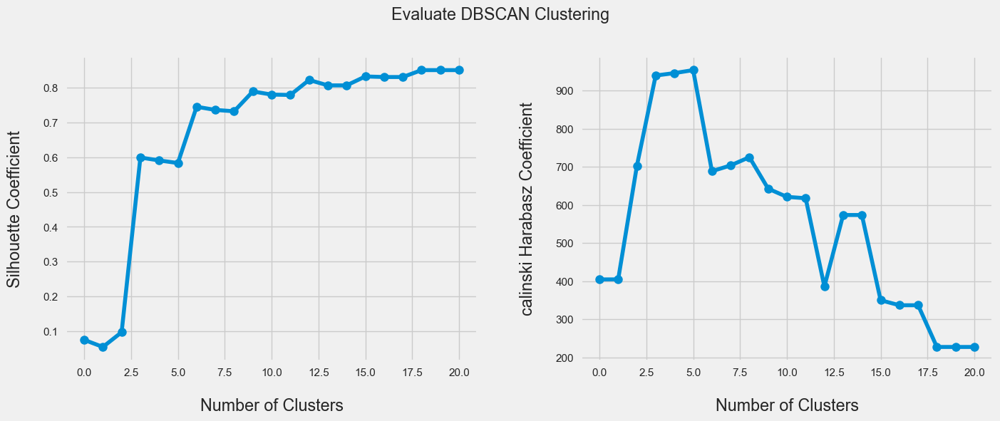

In [186]:
# Draw plots of silhouette_score and calinski_harabasz_score for DBSCAN model
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'DBSCAN', x=range(len(DBSCAN_params)))

In [187]:
# Coordinates of point in above table
for i in enumerate(DBSCAN_params):
    print(i)

(0, (1, 20))
(1, (1, 30))
(2, (1, 40))
(3, (3, 20))
(4, (3, 30))
(5, (3, 40))
(6, (5, 20))
(7, (5, 30))
(8, (5, 40))
(9, (7, 20))
(10, (7, 30))
(11, (7, 40))
(12, (9, 20))
(13, (9, 30))
(14, (9, 40))
(15, (11, 20))
(16, (11, 30))
(17, (11, 40))
(18, (13, 20))
(19, (13, 30))
(20, (13, 40))


In [86]:
# Find best eps and min_samples value
eps_values = np.arange(3,5,0.25) # eps values to be investigated
min_samples = np.arange(20,41,10) # min_samples values to be investigated

DBSCAN_params = list(product(eps_values, min_samples))

In [87]:
# Check optimom n_clusters for implement birch by using silhouette and calinski coefficient
silhouette_coef = []
num_of_clusters = []
for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = silhouette_score(df2, dbscan.labels_)
    silhouette_coef.append(score)
    # for check number of clusters
    num_of_clusters.append(len(np.unique(dbscan.labels_)))

calinski_harabasz_coef = []
for param in DBSCAN_params:
    dbscan = DBSCAN(eps=param[0], min_samples=param[1])
    dbscan.fit(df2)
    score = calinski_harabasz_score(df2, dbscan.labels_)
    calinski_harabasz_coef.append(score)


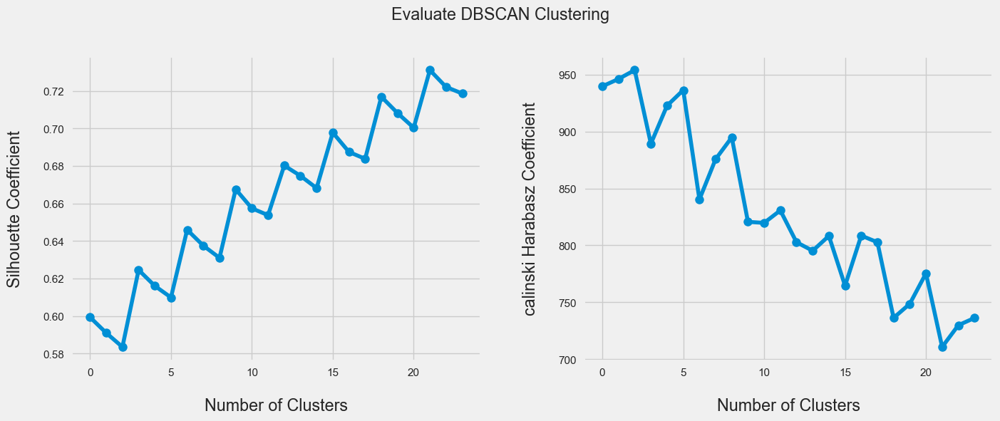

In [88]:
# Draw plots of silhouette_score and calinski_harabasz_score for DBSCAN model
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'DBSCAN', x=range(len(DBSCAN_params)))

In [89]:
# Coordinates of point in above table
for i in enumerate(DBSCAN_params):
    print(i)

(0, (3.0, 20))
(1, (3.0, 30))
(2, (3.0, 40))
(3, (3.25, 20))
(4, (3.25, 30))
(5, (3.25, 40))
(6, (3.5, 20))
(7, (3.5, 30))
(8, (3.5, 40))
(9, (3.75, 20))
(10, (3.75, 30))
(11, (3.75, 40))
(12, (4.0, 20))
(13, (4.0, 30))
(14, (4.0, 40))
(15, (4.25, 20))
(16, (4.25, 30))
(17, (4.25, 40))
(18, (4.5, 20))
(19, (4.5, 30))
(20, (4.5, 40))
(21, (4.75, 20))
(22, (4.75, 30))
(23, (4.75, 40))


In [188]:
# Implement DBSCAN for best eps and min_sample obtained from above
dbscan = DBSCAN(eps=3.5, min_samples=40)
dbscan.fit(df2)
# Store result of DBSCAN
pred = dbscan.labels_
# Number of cluster
num_of_clusters = len(np.unique(pred))
# Evaluate results of mean shift by silhouette and calinski coefficient
sh_score = silhouette_score(df2, pred)
ch_score = calinski_harabasz_score(df2, pred)
# Print results
print(colored(f"Number of cluster: {np.unique(pred)}",'red'))
print(colored(f"Silhouette Coefficient: {sh_score:.2f}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {ch_score:.2f}", 'red'))

Number of cluster: [-1  0]
Silhouette Coefficient: 0.63
Calinski Harabasz Coefficient: 894.82


In [189]:
# Store results obtained from DBSCAN
best_model.loc[len(best_model.index)] = [
    f"DBSCAN",
    silhouette_score(df2, pred),
    calinski_harabasz_score(df2, pred),
    {"eps":3.5, "min_samples":40}]

In [190]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250521,1604.176695,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mini Batch Kmeans,0.199886,1574.141345,"{'n_clusters': 3, 'random_state': 42}"
2,Mean Shift,0.749819,264.325131,{'bandwidth': 12}
3,BIRCH,0.189464,1396.264548,"{'n_clusters': 2, 'threshold': 0.0001}"
4,DBSCAN,0.631053,894.824493,"{'eps': 3.5, 'min_samples': 40}"


In [93]:
# Adding the clusters column to the main dataframe (df2) and store in new dataframe
df_result_dbscan = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_dbscan[:-1]

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0.0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0.0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0.0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,864.206542,0.000000,12.0,0.0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0.0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,864.206542,0.000000,6.0,0.0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0.0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0.0


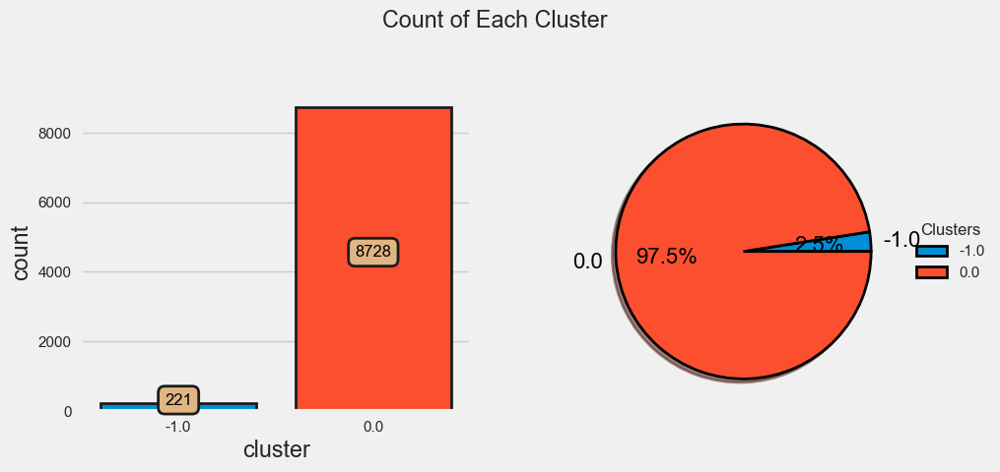

In [94]:
# Implement check_result function for DBSCAN model
check_result(df_result_dbscan)

In [191]:
# Draw dondrogram for Agglomerative clustering
def dendoOptimizer(data):
    """Plots a Dendogram Plot on the data provided"""
    sch.dendrogram(sch.linkage(data, method='ward'))
    plt.title('Dendrogram')
    plt.xlabel('Customers')
    plt.ylabel('Euclidean distances')
    plt.show()

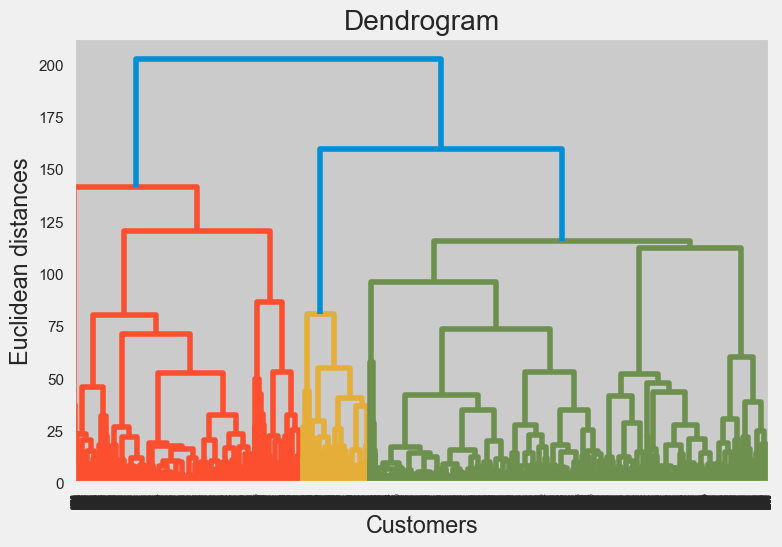

In [192]:
# Implement dendoOptimizer
dendoOptimizer(df2)

In [193]:
# Find optimom bandwidth for implement agglomerative clustering by using silhouette and calinski coefficient
silhouette_coef = []
for k in range(2,15):
    agg = AgglomerativeClustering(n_clusters=k)
    agg.fit(df2)
    score = silhouette_score(df2, agg.fit_predict(df2))
    silhouette_coef.append(score)

calinski_harabasz_coef = []
for k in range(2,15):
    agg = AgglomerativeClustering(n_clusters=k)
    agg.fit(df2)
    score = calinski_harabasz_score(df2, agg.fit_predict(df2))
    calinski_harabasz_coef.append(score)

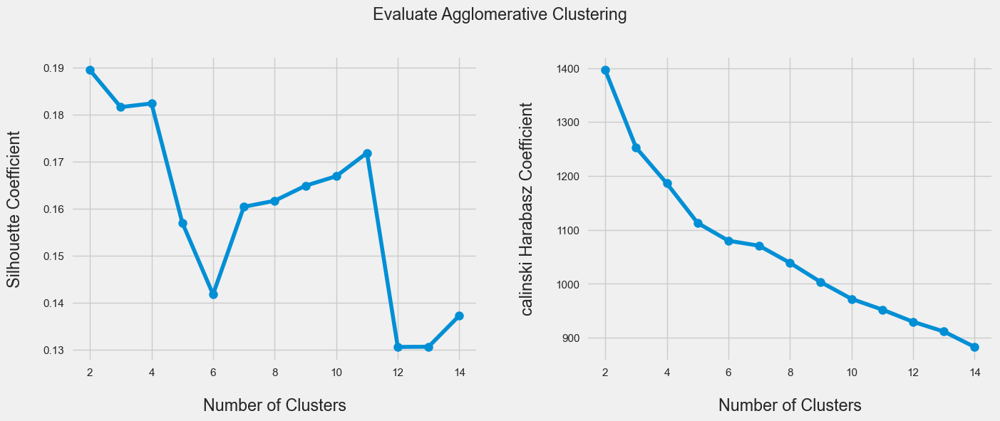

In [194]:
# Draw plots of silhouette_score and calinski_harabasz_score for AgglomerativeClustering models
plot_evaluation(silhouette_coef, calinski_harabasz_coef, 'Agglomerative', x=range(2,15))

In [195]:
# Implement AgglomerativeClustering by n_clusters=2
agg = AgglomerativeClustering(n_clusters=2)
agg.fit(df2)
# Store result of Agglomerative
pred = agg.labels_
# Evaluate results of mean shift by silhouette and calinski coefficient
sh_score = silhouette_score(df2, pred)
ch_score = calinski_harabasz_score(df2, pred)
# Print results
print(colored(f"Silhouette Coefficient: {sh_score:.2f}", 'red'))
print(colored(f"Calinski Harabasz Coefficient: {ch_score:.2f}", 'red'))
# Adding the clusters column to the main dataframe (df2) and store in new dataframe
df_result_agg = pd.concat([df1, pd.DataFrame(pred, columns=['cluster'])], axis = 1)
df_result_agg[:-1]

Silhouette Coefficient: 0.19
Calinski Harabasz Coefficient: 1396.26


,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.000000,12.0,0.0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4.0,0.0,7000.0,4103.032597,1072.340217,0.222222,12.0,0.0
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.000000,12.0,0.0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,864.206542,0.000000,12.0,0.0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.000000,12.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8945,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,325.594462,48.886365,0.500000,6.0,0.0
8946,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0.0,6.0,1000.0,275.861322,864.206542,0.000000,6.0,0.0
8947,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0.0,5.0,1000.0,81.270775,82.418369,0.250000,6.0,0.0
8948,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2.0,0.0,500.0,52.549959,55.755628,0.250000,6.0,0.0


In [196]:
# Store results obtained from AgglomerativeClustering
best_model.loc[len(best_model.index)] = [
    f"Agglomerative",
    silhouette_score(df2, pred),
    calinski_harabasz_score(df2, pred),
    {"n_clusters":2}]

In [197]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250521,1604.176695,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mini Batch Kmeans,0.199886,1574.141345,"{'n_clusters': 3, 'random_state': 42}"
2,Mean Shift,0.749819,264.325131,{'bandwidth': 12}
3,BIRCH,0.189464,1396.264548,"{'n_clusters': 2, 'threshold': 0.0001}"
4,DBSCAN,0.631053,894.824493,"{'eps': 3.5, 'min_samples': 40}"
5,Agglomerative,0.189464,1396.264548,{'n_clusters': 2}


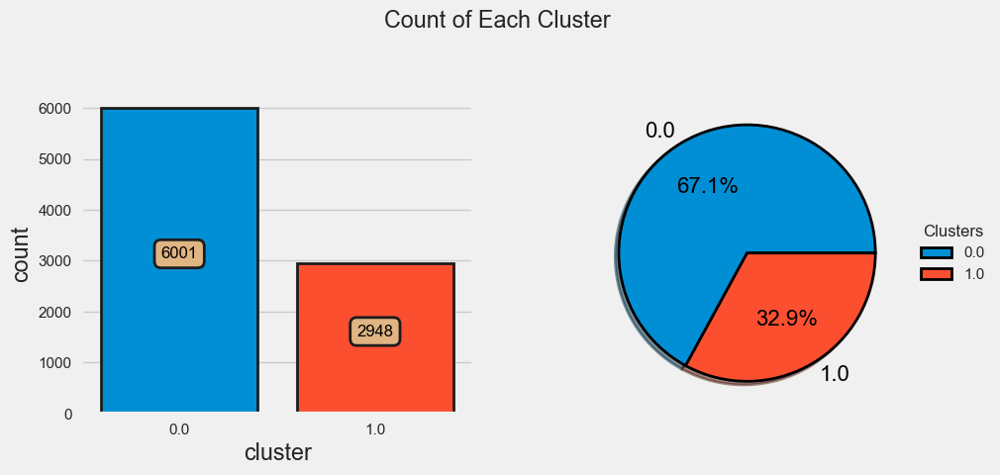

In [102]:
# Implement check_result function for AgglomerativeClustering model
check_result(df_result_agg)

In [103]:
best_model

,Model,Sil_score,CH_score,setting
0,Kmeans,0.250521,1604.176695,"{'n_clusters': 3, 'init': 'random', 'n_init': ..."
1,Mini Batch Kmeans,0.199886,1574.141345,"{'n_clusters': 3, 'random_state': 42}"
2,Mean Shift,0.749819,264.325131,{'bandwidth': 12}
3,BIRCH,0.189464,1396.264548,"{'n_clusters': 2, 'threshold': 0.0001}"
4,DBSCAN,0.631053,894.824493,"{'eps': 3.5, 'min_samples': 40}"
5,Agglomerative,0.189464,1396.264548,{'n_clusters': 2}


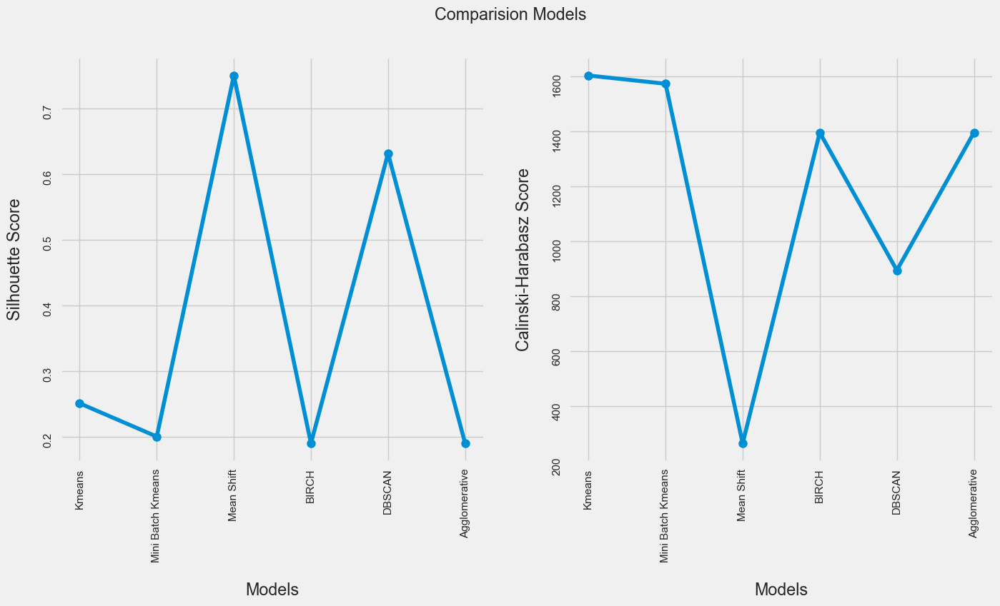

In [105]:
# Show results obtained from different models in plot
fig, ax = plt.subplots(1,2,figsize=(15,7), dpi=100)
ax[0].plot(best_model.Model, best_model.Sil_score, marker='o', ms=9)
ax[1].plot(best_model.Model, best_model.CH_score, marker='o', ms=9)
ax[0].set_xlabel("Models", labelpad=20)
ax[0].set_ylabel("Silhouette Score", labelpad=20)
ax[1].set_xlabel("Models", labelpad=20)
ax[1].set_ylabel("Calinski-Harabasz Score", labelpad=20)
ax[0].tick_params(labelrotation=90) 
ax[1].tick_params(labelrotation=90) 
plt.suptitle(f'Comparision Models')
plt.show()